# <p><center style="font-family:newtimeroman;font-size:180%;">Bank Marketing 🕵️‍♂️🕵️‍♂️</center></p>

### Team Members 🕵️‍♂️🕵️‍♂️:

1. Ahmed Ashraf Ahmed Alsayed (Leader)
2. Ahmed Elsayed Ahmed Hassan (اجبارى)
3. Ahmed Elsayed Mahmoud Arafa
4. Radwa Mohamed Said Abd El- Shafi (Meme Lord)
5. Abdelrahman Abdo Hassan Ahmed
6. Nada Adel Ismael Hussainen Shahin
7. Hani Yasser ElMetwaly Sorour Ahmed

### Table of contents 🕵️‍♂️🕵️‍♂️:

* [Introduction 🕵️‍♂️🕵️‍♂️](#0)
* [Import Libraries 🕵️‍♂️🕵️‍♂️](#1)
* [Read Data 🕵️‍♂️🕵️‍♂️](#2)
* [EDA 🕵️‍♂️🕵️‍♂️](#3)
* [PreProcessing 🕵️‍♂️🕵️‍♂️](#4)
* [ML Models 🕵️‍♂️🕵️‍♂️](#5)
* [DL Models 🕵️‍♂️🕵️‍♂️](#6)


**<a id="0"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">Introduction 🕵️‍♂️🕵️‍♂️</p>
<a class="btn" href="#home">Tabel of Contents</a>

                                                Dataset
1. Title: Bank Marketing.
2. Sources Created by: Sérgio Moro (ISCTE-IUL), Paulo Cortez (Univ. Minho) and Paulo Rita (ISCTE-IUL).
3. Past Usage: The full dataset (bank-additional-full.csv) was described and analyzed in: S. Moro, P. Cortez, and P. Rita. A Data-Driven Approach to Predict the Success of Bank Telemarketing.
4. Relevant Information: This dataset is based on "Bank Marketing" UCI dataset (check the description at: http://archive.ics.uci.edu/ml/datasets/Bank+Marketing.
5. Number of Instances: 41188 for bank-additional-full.csv
6. Number of Attributes: 20 + output attribute.
7. Attribute information:


 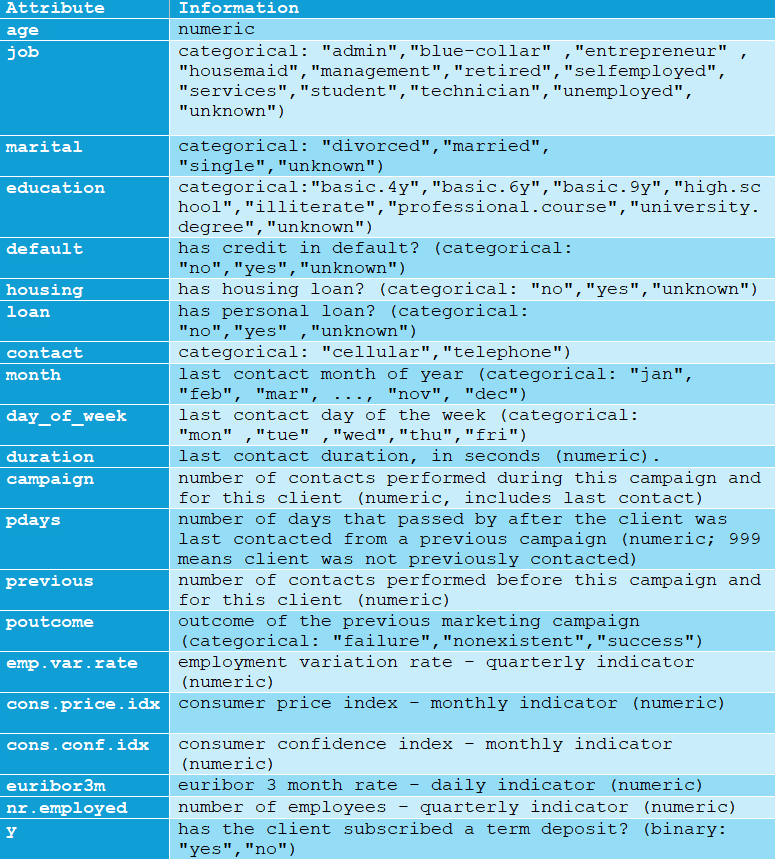


8. Missing Attribute Values: There are several missing values in some categorical attributes, all coded with the "unknown" label. These missing values can be treated as a possible class label or using deletion or imputation techniques.

**<a id="1"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">Import Libraries 🕵️‍♂️🕵️‍♂️</p>
<a class="btn" href="#home">Tabel of Contents</a>

In [1]:
pip install yellowbrick

Note: you may need to restart the kernel to use updated packages.


In [2]:
import pandas as pd
import numpy as np
from plotly.offline import init_notebook_mode
import plotly.graph_objs as go
import cufflinks as cf
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
init_notebook_mode(connected=True)
cf.go_offline()
from sklearn.metrics import confusion_matrix,ConfusionMatrixDisplay
from sklearn.metrics import classification_report
from imblearn.over_sampling import RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler
import warnings
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
from sklearn.feature_selection import SelectFromModel
from sklearn.model_selection import KFold
from sklearn.metrics import mean_absolute_error 
from sklearn.metrics import mean_squared_error 
from sklearn.metrics import median_absolute_error
from sklearn.metrics import f1_score,accuracy_score,r2_score
from sklearn.metrics import recall_score
from sklearn.metrics import precision_score
from sklearn.metrics import roc_curve,RocCurveDisplay
from sklearn.metrics import auc
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering
import scipy.cluster.hierarchy as sch
from sklearn.decomposition import PCA
from yellowbrick.cluster import KElbowVisualizer
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import Ridge
from sklearn.pipeline import Pipeline
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import PolynomialFeatures
import keras
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt

2024-05-06 12:53:12.349317: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-05-06 12:53:12.349476: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-05-06 12:53:12.503281: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


**<a id="2"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">Read Data 🕵️‍♂️🕵️‍♂️</p>
<a class="btn" href="#home">Tabel of Contents</a>

> Read in the csv file as a dataframe called data

    The tabulated data is meticulously arranged, featuring distinct columns housing a range of diverse information. Column values are delimited by semicolons (;), hinting at the possibility that the data has been stored in CSV format, utilizing commas to separate values.

In [3]:
data=pd.read_csv('/kaggle/input/bank-marketing/bank-additional-full.csv',sep=';')

> Check the head of data

In [4]:
data.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no


> Check the shape of data

In [5]:
data.shape

(41188, 21)

    The dataset comprises 41,188 rows and 21 columns

> Check the info of data

In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41188 entries, 0 to 41187
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             41188 non-null  int64  
 1   job             41188 non-null  object 
 2   marital         41188 non-null  object 
 3   education       41188 non-null  object 
 4   default         41188 non-null  object 
 5   housing         41188 non-null  object 
 6   loan            41188 non-null  object 
 7   contact         41188 non-null  object 
 8   month           41188 non-null  object 
 9   day_of_week     41188 non-null  object 
 10  duration        41188 non-null  int64  
 11  campaign        41188 non-null  int64  
 12  pdays           41188 non-null  int64  
 13  previous        41188 non-null  int64  
 14  poutcome        41188 non-null  object 
 15  emp.var.rate    41188 non-null  float64
 16  cons.price.idx  41188 non-null  float64
 17  cons.conf.idx   41188 non-null 

    The dataset includes 5 columns of floating-point values, 5 columns of integers, and 11 columns of object data types.

>Description of data

    If the DataFrame contains numerical data, the description contains these information for each column:

    count - The number of not-empty values.
    mean - The average (mean) value.
    std - The standard deviation.
    min - the minimum value.
    25% - The 25% percentile*.
    50% - The 50% percentile*.
    75% - The 75% percentile*.
    max - the maximum value.

In [7]:
data.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
age,41188.0,40.024060,10.421250,17.000,32.000,38.000,47.000,98.000
duration,41188.0,258.285010,259.279249,0.000,102.000,180.000,319.000,4918.000
campaign,41188.0,2.567593,2.770014,1.000,1.000,2.000,3.000,56.000
pdays,41188.0,962.475454,186.910907,0.000,999.000,999.000,999.000,999.000
previous,41188.0,0.172963,0.494901,0.000,0.000,0.000,0.000,7.000
emp.var.rate,41188.0,0.081886,1.570960,-3.400,-1.800,1.100,1.400,1.400
cons.price.idx,41188.0,93.575664,0.578840,92.201,93.075,93.749,93.994,94.767
cons.conf.idx,41188.0,-40.502600,4.628198,-50.800,-42.700,-41.800,-36.400,-26.900
euribor3m,41188.0,3.621291,1.734447,0.634,1.344,4.857,4.961,5.045
nr.employed,41188.0,5167.035911,72.251528,4963.600,5099.100,5191.000,5228.100,5228.100


    For object data types, the describe method typically includes:

    Count: The number of non-empty values.
    Unique: The number of unique values.
    Top: The most frequently occurring value.
    Freq: The frequency of the top value.

In [8]:
data.describe(include='O').transpose()

,count,unique,top,freq
job,41188,12,admin.,10422
marital,41188,4,married,24928
education,41188,8,university.degree,12168
default,41188,3,no,32588
housing,41188,3,yes,21576
loan,41188,3,no,33950
contact,41188,2,cellular,26144
month,41188,10,may,13769
day_of_week,41188,5,thu,8623
poutcome,41188,3,nonexistent,35563


>check for null values in the data

    Missing Attribute Values: There are several missing values in some categorical attributes, all coded with the "unknown" label. These missing values can be treated as a possible class label or using deletion or imputation techniques. 🕵️‍♂️🕵️‍♂️ Replace UnKnown to NAN

In [9]:
data.replace("unknown",np.nan,inplace=True)

In [10]:
is_null,precentage = data.isnull().sum(),(data.isnull().sum()/data.shape[0])*100
df = pd.DataFrame()
df['Count'],df['Precentage%']=is_null,precentage
df

,Count,Precentage%
age,0,0.000000
job,330,0.801204
marital,80,0.194231
education,1731,4.202680
default,8597,20.872584
housing,990,2.403613
loan,990,2.403613
contact,0,0.000000
month,0,0.000000
day_of_week,0,0.000000


    Based on the provided data frame:

     The "age" column has 0 missing values, accounting for 0% of the total.
     The "job" column has 330 missing values, making up about 0.80% of the total.
     The "marital" column has 80 missing values, representing approximately 0.19% of the total.
     The "education" column has 1731 missing values, comprising around 4.20% of the total.
     The "default" column has 8597 missing values, accounting for about 20.87% of the total.
     The "housing" and "loan" columns each have 990 missing values, accounting for about 2.40% of the total for each column.
     The columns "contact", "month", "day_of_week", "duration", "campaign", "pdays", "previous", "poutcome", "emp.var.rate", "cons.price.idx", "cons.conf.idx", "euribor3m", "nr.employed", and "y" have no missing values.

> Handle null values

    To handle null values in your dataset, you can use various methods depending on the type of data and the nature of the missing values. Here are some common approaches for both numerical and categorical data:

    For Numerical Data:
    1. Mean/Median Imputation: Replace missing values with the mean or median of the column.
    2. Random Imputation: Replace missing values with randomly sampled values from the distribution of the existing data.
    3. Predictive Imputation: Use a predictive model to predict missing values based on other variables in the dataset.

    For Categorical Data:
    1. Most Frequent Imputation: Replace missing values with the most frequent value in the column.
    2. Constant Imputation: Replace missing values with a specific constant value.
    3. Predictive Imputation: You can also use a predictive model tailored for categorical data to predict missing values.

    Best Practices:
    all null columns object In this case, using Most Frequent Imputation for handling missing values in categorical data seems appropriate.

In [11]:
data.mode().iloc[0]

age                            31.0
job                          admin.
marital                     married
education         university.degree
default                          no
housing                         yes
loan                             no
contact                    cellular
month                           may
day_of_week                     thu
duration                         85
campaign                        1.0
pdays                         999.0
previous                        0.0
poutcome                nonexistent
emp.var.rate                    1.4
cons.price.idx               93.994
cons.conf.idx                 -36.4
euribor3m                     4.857
nr.employed                  5228.1
y                                no
Name: 0, dtype: object

In [12]:
data.fillna(data.mode().iloc[0],inplace=True)

In [13]:
is_null,precentage = data.isnull().sum(),(data.isnull().sum()/data.shape[0])*100
df = pd.DataFrame()
df['Count'],df['Precentage%']=is_null,precentage
df

,Count,Precentage%
age,0,0.0
job,0,0.0
marital,0,0.0
education,0,0.0
default,0,0.0
housing,0,0.0
loan,0,0.0
contact,0,0.0
month,0,0.0
day_of_week,0,0.0


>check duplicate data

    data[data.duplicated(keep=False)]
    returns all rows in the DataFrame that are duplicates, including both the original rows and their duplicates. The `keep=False` parameter ensures that all instances of duplicate rows are returned. If a row appears more than once in the DataFrame, it will be included in the output. 

In [14]:
data[data.duplicated(keep=False)]

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
236,56,blue-collar,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1265,39,blue-collar,married,basic.6y,no,no,no,telephone,may,thu,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.855,5191.0,no
1266,39,blue-collar,married,basic.6y,no,no,no,telephone,may,thu,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.855,5191.0,no
5664,56,blue-collar,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
12260,36,retired,married,university.degree,no,no,no,telephone,jul,thu,...,1,999,0,nonexistent,1.4,93.918,-42.7,4.966,5228.1,no
12261,36,retired,married,university.degree,no,no,no,telephone,jul,thu,...,1,999,0,nonexistent,1.4,93.918,-42.7,4.966,5228.1,no
14155,27,technician,single,professional.course,no,no,no,cellular,jul,mon,...,2,999,0,nonexistent,1.4,93.918,-42.7,4.962,5228.1,no
14234,27,technician,single,professional.course,no,no,no,cellular,jul,mon,...,2,999,0,nonexistent,1.4,93.918,-42.7,4.962,5228.1,no
16819,47,technician,divorced,high.school,no,yes,no,cellular,jul,thu,...,3,999,0,nonexistent,1.4,93.918,-42.7,4.962,5228.1,no
16956,47,technician,divorced,high.school,no,yes,no,cellular,jul,thu,...,3,999,0,nonexistent,1.4,93.918,-42.7,4.962,5228.1,no


    keep='first': When you use data.duplicated(keep='first')
    it identifies and marks duplicates in the DataFrame, keeping only the first occurrence of each duplicated row as non-duplicate.

In [15]:
data[data.duplicated(keep='first')]

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
1266,39,blue-collar,married,basic.6y,no,no,no,telephone,may,thu,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.855,5191.0,no
5664,56,blue-collar,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
12261,36,retired,married,university.degree,no,no,no,telephone,jul,thu,...,1,999,0,nonexistent,1.4,93.918,-42.7,4.966,5228.1,no
14234,27,technician,single,professional.course,no,no,no,cellular,jul,mon,...,2,999,0,nonexistent,1.4,93.918,-42.7,4.962,5228.1,no
16956,47,technician,divorced,high.school,no,yes,no,cellular,jul,thu,...,3,999,0,nonexistent,1.4,93.918,-42.7,4.962,5228.1,no
18465,32,technician,single,professional.course,no,yes,no,cellular,jul,thu,...,1,999,0,nonexistent,1.4,93.918,-42.7,4.968,5228.1,no
19608,33,admin.,married,university.degree,no,yes,no,cellular,aug,thu,...,1,999,0,nonexistent,1.4,93.444,-36.1,4.968,5228.1,no
20216,55,services,married,high.school,no,no,no,cellular,aug,mon,...,1,999,0,nonexistent,1.4,93.444,-36.1,4.965,5228.1,no
20534,41,technician,married,professional.course,no,yes,no,cellular,aug,tue,...,1,999,0,nonexistent,1.4,93.444,-36.1,4.966,5228.1,no
25217,39,admin.,married,university.degree,no,no,no,cellular,nov,tue,...,2,999,0,nonexistent,-0.1,93.200,-42.0,4.153,5195.8,no


    keep='last': Conversely, when you use data.duplicated(keep='last')
    it also identifies and marks duplicates in the DataFrame. However, it keeps only the last occurrence of each duplicated row as non-duplicate.

In [16]:
data[data.duplicated(keep='last')]

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
236,56,blue-collar,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1265,39,blue-collar,married,basic.6y,no,no,no,telephone,may,thu,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.855,5191.0,no
12260,36,retired,married,university.degree,no,no,no,telephone,jul,thu,...,1,999,0,nonexistent,1.4,93.918,-42.7,4.966,5228.1,no
14155,27,technician,single,professional.course,no,no,no,cellular,jul,mon,...,2,999,0,nonexistent,1.4,93.918,-42.7,4.962,5228.1,no
16819,47,technician,divorced,high.school,no,yes,no,cellular,jul,thu,...,3,999,0,nonexistent,1.4,93.918,-42.7,4.962,5228.1,no
18464,32,technician,single,professional.course,no,yes,no,cellular,jul,thu,...,1,999,0,nonexistent,1.4,93.918,-42.7,4.968,5228.1,no
19451,33,admin.,married,university.degree,no,yes,no,cellular,aug,thu,...,1,999,0,nonexistent,1.4,93.444,-36.1,4.968,5228.1,no
20072,55,services,married,high.school,no,no,no,cellular,aug,mon,...,1,999,0,nonexistent,1.4,93.444,-36.1,4.965,5228.1,no
20531,41,technician,married,professional.course,no,yes,no,cellular,aug,tue,...,1,999,0,nonexistent,1.4,93.444,-36.1,4.966,5228.1,no
25183,39,admin.,married,university.degree,no,no,no,cellular,nov,tue,...,2,999,0,nonexistent,-0.1,93.200,-42.0,4.153,5195.8,no


> Remove duplicates

    Remove duplicates keeping the first occurrence

In [17]:
data.drop_duplicates(keep='first', inplace=True)

In [18]:
data[data.duplicated()]

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y


**<a id="3"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">EDA 🕵️‍♂️🕵️‍♂️</p>
<a class="btn" href="#home">Tabel of Contents</a>

    Exploratory Data Analysis (EDA) is a crucial step in data analysis where you explore and summarize key characteristics of a dataset. This process involves techniques to gain insights, identify patterns, detect anomalies, and test hypotheses. Common methods used in EDA include summary statistics, data visualization (like histograms, scatter plots, box plots).

    Helper Functions

In [19]:
def hist_hue(feature,hue,title_f,title_h,title):
    num_bins=20
    total_hist, _ = np.histogram(data[feature], bins=num_bins)
    fig = make_subplots(rows=1, cols=2, subplot_titles=(title_f, f"{title_f} VS {title_h}"))
    histogram_trace_total = go.Bar(x=np.arange(num_bins), y=total_hist, name=title_f, text=total_hist, textposition='inside')
    fig.add_trace(histogram_trace_total, row=1, col=1)
    for category in data[hue].unique():
        category_data = data[data[hue] == category][feature]
        category_hist, _ = np.histogram(category_data, bins=num_bins)
        histogram_trace_by_hue = go.Bar(x=np.arange(num_bins), y=category_hist, name=f'{title_f} VS {title_h} ({category})', text=category_hist, textposition='inside')
        fig.add_trace(histogram_trace_by_hue, row=1, col=2)
    fig.update_layout(
       title_text=title,
       title_x=0.5, 
       title_font=dict(size=20),
       font=dict(size=15),
       width=1000,
       height=700,
       barmode='stack',
       template='plotly_dark',
        xaxis_title=title_f,
        yaxis_title='Count',
        xaxis2_title=title_f,
    )
    fig.update_annotations(font=dict(size=20))
    fig.show()

In [20]:
def Bar_hue(feature,hue,title_f,title_h,title):
    fig = make_subplots(rows=1, cols=2, subplot_titles=(title_f, f"{title_f} VS {title_h}"))
    distribution = data[feature].value_counts()
    bar_trace = go.Bar(x=distribution.index, y=distribution.values, name=title_f,text=distribution.values, textposition='inside')
    fig.add_trace(bar_trace, row=1, col=1)
    for category in data[hue].unique():
        category_data = data[data[hue] == category][feature].value_counts()
        bar_trace_by_hue = go.Bar(x=category_data.index, y=category_data.values, name=f'{title_f} VS {title_h} ({category})', text=category_data.values, textposition='inside')
        fig.add_trace(bar_trace_by_hue, row=1, col=2)
    fig.update_layout(
        title_text=title,
        title_x=0.5,
        title_font=dict(size=20),
        xaxis_title=title_f,
        yaxis_title='Count',
        xaxis2_title=title_f,
        font=dict(size=15), 
        barmode='stack',
        width=1000,
        height=700,
        xaxis=dict(tickangle=-90),
        xaxis2=dict(tickangle=-90),
        template='plotly_dark'
    )
    fig.update_annotations(font=dict(size=20))
    fig.show()

In [21]:
def Bar_2hue(feature,hue1,title_f,title_h1,title='',make_subplot=True,hue2='',title_h2=''):
    if make_subplot:
        fig = make_subplots(rows=1, cols=2, subplot_titles=(f"{title_f} VS {title_h1}",f"{title_f} VS {title_h2}"))
        for category in data[hue1].unique():
            category_data = data[data[hue1] == category][feature].value_counts()
            bar_trace_by_hue = go.Bar(x=category_data.index, y=category_data.values, name=f'{title_f} VS {title_h1} ({category})',text=category_data.values, textposition='inside')
            fig.add_trace(bar_trace_by_hue, row=1, col=1)
        for category in data[hue2].unique():
            category_data = data[data[hue2] == category][feature].value_counts()
            bar_trace_by_hue = go.Bar(x=category_data.index, y=category_data.values, name=f'{title_f} VS {title_h2} ({category})',text=category_data.values, textposition='inside')
            fig.add_trace(bar_trace_by_hue, row=1, col=2)
        fig.update_layout(
            title_text=title,
            title_x=0.5,
            title_font=dict(size=20),
            xaxis_title=title_f,
            yaxis_title='Count',
            xaxis2_title=title_f,
            font=dict(
                size=15,
            ),   
            barmode='stack',
            width=1000,
            height=700,
            xaxis=dict(tickangle=-90),
            xaxis1=dict(tickangle=-90),
            xaxis2=dict(tickangle=-90),
            template='plotly_dark'
        )
        fig.update_annotations(font=dict(size=20))
        fig.show()
    else: 
        fig = go.Figure()
        for category in data[hue1].unique():
            category_data = data[data[hue1] == category][feature].value_counts()
            bar_trace_by_hue = go.Bar(x=category_data.index, y=category_data.values, name=f'{title_f} VS {title_h1} ({category})',text=category_data.values, textposition='inside')
            fig.add_trace(bar_trace_by_hue)
        fig.update_layout(
            title_text=f'{title_f} VS {title_h1}',
            title_x=0.5,
            title_font=dict(size=20),
            xaxis_title=title_f,
            yaxis_title='Count',
            font=dict(
                size=15,
            ),   
            barmode="stack",
            width=800,
            height=700,
            xaxis=dict(tickangle=-90),
            template='plotly_dark'
        )
        fig.update_annotations(font=dict(size=20))
        fig.show()

In [22]:
def Boxplot_outlier(feature,title):
    fig = make_subplots(rows=1, cols=2, subplot_titles=("Box Plot", "Violin Plot"))
    fig.add_trace(
        go.Box(y=data[feature], name='BoxPlot'),
        row=1, col=1
    )
    fig.add_trace(
        go.Violin(y=data[feature], name='ViolinPlot'),
        row=1, col=2
    )
    fig.update_layout(
        title_text=title,
        title_x=0.5,
        title_font=dict(size=20),
        font=dict(size=15),
        width=1000,
        height=500,
        template='plotly_dark'
    )
    fig.update_annotations(font=dict(size=20))
    fig.show()

In [23]:
def Pie(feature,title_f,title):
    distribution = data[feature].value_counts()
    pie_trace = go.Pie(labels=distribution.index, values=distribution.values, name=title_f)
    pie_layout = go.Layout(
        title=title,
        title_font=dict(size=20),
        width=600,
        height=500,
        title_x=0.5,
        template='plotly_dark'
    )
    fig_pie = go.Figure(data=[pie_trace], layout=pie_layout)
    fig_pie.show()

In [24]:
def Heatmap(pivot1, title, feature, feature_h1, make_subplot=True, feature_h2='', pivot2='', color='inferno'):
    fig_heatmap = None  
    if make_subplot:
        fig = make_subplots(rows=1, cols=2, subplot_titles=(f"{feature} VS {feature_h1}", f"{feature} VS {feature_h2}"))
        heat1 = go.Heatmap(
            z=pivot1.values,
            x=pivot1.columns,
            y=pivot1.index,
            colorscale=color,
            colorbar=dict(title='Count'),  
            colorbar_x=0.45,  
            colorbar_len=0.8  
        )
        fig.add_trace(heat1, row=1, col=1)
        heat2 = go.Heatmap(
            z=pivot2.values,
            x=pivot2.columns,
            y=pivot2.index,
            colorscale=color,
            colorbar=dict(title='Count'),  
            colorbar_x=1,  
            colorbar_len=0.8
        )
        fig.add_trace(heat2, row=1, col=2)
        fig.update_layout(
            title=title,
            title_x=0.5,
            title_font=dict(size=20),
            width=1100,
            height=500,
            xaxis=dict(title=feature_h1, tickangle=-90),
            xaxis2=dict(title=feature_h2, tickangle=-90),
            yaxis=dict(title=feature, tickangle=-90),
            yaxis2=dict(tickangle=-90),
            font=dict(size=15),
            template='plotly_dark'
        )
        fig_heatmap = fig  
    else:
        fig_heatmap = go.Figure(data=go.Heatmap(
            z=pivot1.values,
            x=pivot1.columns,
            y=pivot1.index,
            colorscale=color,
            colorbar=dict(title='Count')
        ))
        fig_heatmap.update_layout(
            title=title,
            title_x=0.5,
            title_font=dict(size=20),
            xaxis=dict(title=feature_h1),
            yaxis=dict(title=feature),
            font=dict(size=15),
            width=800,
            height=500,
            template='plotly_dark'
        )
    fig_heatmap.update_annotations(font=dict(size=20))
    fig_heatmap.show()

In [25]:
def mean_plot(pivot_table,feature,hue,feature_t,hue_t):
    fig = go.Figure()
    for i in data[hue].unique():
        cate = pivot_table[pivot_table.index==i]
        bar_trace = go.Bar(x=cate.index, y=cate[feature], text=round(cate[feature],2), textposition='inside', name=i)
        fig.add_trace(bar_trace)
    fig.update_layout(
        title_text=f'Average {feature_t}',
        title_x=0.5,
        title_font=dict(size=20),
        xaxis_title=hue_t,
        yaxis_title='Average',
        font=dict(size=15),
        barmode='stack',
        width=800,
        height=700,
        xaxis=dict(tickangle=-90),
        template='plotly_dark'
    )
    
    fig.update_annotations(font=dict(size=20))
    fig.show()


In [26]:
def pivot(values_f,index_f,mean=True):
    if mean:
        return pd.pivot_table(data, values=values_f, index=index_f, aggfunc='mean')
    else:
        return pd.pivot_table(data, index=values_f, columns=index_f, aggfunc='size', fill_value=0)
def cross_t(index,columns):
    return pd.crosstab(index=data[index], columns=data[columns])

> What is age  distribution?

    Find the minimum age

In [27]:
data.age.min()

17

    Find the maximum age

In [28]:
data.age.max()

98

    Find the top 5 most frequent ages

In [29]:
data['age'].value_counts().head(5)

age
31    1947
32    1845
33    1832
36    1779
35    1758
Name: count, dtype: int64

    Based on the output, it seems that the age group 31 to 36 has the highest counts of observations. Specifically, for ages 31, 32, 33, 35, and 36, the number of observations (count) is as follows:

    Age 31: 1947 observations
    Age 32: 1845 observations
    Age 33: 1832 observations
    Age 35: 1758 observations
    Age 36: 1779 observations

    calculate the mean age for each category in the y column

In [30]:
pivot_table = pivot('age','y')
pivot_table

,age
y,
no,39.910743
yes,40.912266


    Observation: The pivot table reveals that the mean age of individuals who subscribed to the service ("yes" category in the "y" column) is slightly higher (approximately 40.91 years) compared to those who did not subscribe ("no" category), with a mean age of approximately 39.91 years.

    Visualization 

In [31]:
hist_hue('age','y','Age','Y','Age Distribution')

In [32]:
Boxplot_outlier('age','Age Distribution')

    Observation: Based on the figure, it appears that the age column contains some outliers. 

> What is Job distribution?

    calculate the value counts for the job column 

In [33]:
data.job.value_counts().to_frame()

,count
job,
admin.,10748
blue-collar,9252
technician,6739
services,3967
management,2924
retired,1718
entrepreneur,1456
self-employed,1421
housemaid,1060



    Observation: The value counts for the "job" column indicate the frequency of each job category present in the dataset. Here are the observations:

    The most common job category is "admin." with 10,748 occurrences.
    Following "admin.", the next most frequent categories are "blue-collar" (9,252 occurrences) and "technician" (6,739 occurrences).
    Some job categories have relatively fewer occurrences, such as "student" (875 occurrences) and "unemployed" (1,014 occurrences).

     count the occurrences of each combination of job and y

In [34]:
pivot_table = pivot('job','y',False)
pivot_table

y,no,yes
job,,
admin.,9360,1388
blue-collar,8614,638
entrepreneur,1332,124
housemaid,954,106
management,2596,328
retired,1284,434
self-employed,1272,149
services,3644,323
student,600,275


    Visualization

In [35]:
Pie('job','Job','Job Distribution')

In [36]:
Bar_hue('job','y','Job','Y','Job Distribution')

In [37]:
Heatmap(pivot_table,'Job Vs Y Categories','Job','Y',make_subplot=False)

    observation based on figure: show frequency between Job and Y    

> What is marital distribution?

    calculate the value counts for the "marital" column

In [38]:
data.marital.value_counts().to_frame()

,count
marital,
married,24999
single,11564
divorced,4611


    shows the count of each category in the marital status data. For example, there are 24999 married individuals, 11564 singles, and 4611 divorced individuals.

     count the occurrences of each combination of marital and y

In [39]:
pivot_table =pivot('marital','y',False) 
pivot_table

y,no,yes
marital,,
divorced,4135,476
married,22456,2543
single,9944,1620


    count the occurrences of each combination of marital and job 

In [40]:
pivot_table1 = pivot('marital','job',False) 
pivot_table1

job,admin.,blue-collar,entrepreneur,housemaid,management,retired,self-employed,services,student,technician,unemployed
marital,,,,,,,,,,,
divorced,1293,728,179,161,331,348,133,532,9,773,124
married,5506,6699,1074,780,2092,1278,909,2299,42,3681,639
single,3949,1825,203,119,501,92,379,1136,824,2285,251


     count the occurrences of each combination of marital , job and y

In [41]:
data.groupby(['y','job','marital'])['marital'].count().to_frame()

marital
y   job         marital          
no  admin.      divorced     1158
                married      4834
                single       3368
    blue-collar divorced      675
                married      6275
...                           ...
yes technician  married       386
                single        279
    unemployed  divorced       10
                married        86
                single         48

[66 rows x 1 columns]

    Visalization

In [42]:
Pie('marital','Marital','Marital Distribution')

In [43]:
Bar_hue('marital','y','Marital','Y','Marital Distribution')

In [44]:
Bar_2hue('marital','job','Marital','Job',make_subplot=False)

In [45]:
Heatmap(pivot_table,'Marital Distribution','Marital','Y',make_subplot=True,feature_h2='Job',pivot2=pivot_table1)

> What is education distribution?

    calculate the value counts for the education column

In [46]:
data.education.value_counts().to_frame()

,count
education,
university.degree,13893
high.school,9512
basic.9y,6045
professional.course,5240
basic.4y,4175
basic.6y,2291
illiterate,18


    The observation for the education data shows the count of individuals in each category. For instance, there are 13893 individuals with a university degree, 9512 with a high school education, 6045 with a 9-year basic education, 5240 with a professional course background, 4175 with a 4-year basic education, 2291 with a 6-year basic education, and only 18 individuals who are illiterate.

    count the occurrences of each combination of education and y

In [47]:
pivot_table = pivot('education','y',False) 
pivot_table

y,no,yes
education,,
basic.4y,3747,428
basic.6y,2103,188
basic.9y,5572,473
high.school,8481,1031
illiterate,14,4
professional.course,4645,595
university.degree,11973,1920


    count the occurrences of each combination of education and job

In [48]:
pivot_table1 = pivot('education','job',False) 
pivot_table1

job,admin.,blue-collar,entrepreneur,housemaid,management,retired,self-employed,services,student,technician,unemployed
education,,,,,,,,,,,
basic.4y,129,2317,137,474,100,597,93,132,26,58,112
basic.6y,173,1425,71,77,85,75,25,226,13,87,34
basic.9y,530,3623,210,94,166,145,220,388,99,384,186
high.school,3366,878,234,174,298,276,118,2680,357,872,259
illiterate,1,8,2,1,0,3,3,0,0,0,0
professional.course,375,453,135,59,89,241,168,218,43,3317,142
university.degree,6174,548,667,181,2186,381,794,323,337,2021,281


    count the occurrences of each combination of education and marital

In [49]:
pivot_table2 = pivot('education','marital',False) 
pivot_table2

marital,divorced,married,single
education,,,
basic.4y,489,3233,453
basic.6y,182,1772,337
basic.9y,565,4164,1316
high.school,1192,5171,3149
illiterate,2,15,1
professional.course,657,3161,1422
university.degree,1524,7483,4886


     count the occurrences of each combination of education , job , marital and y

In [50]:
data.groupby(['y','job','marital','education'])['education'].count().to_frame()

education
y   job        marital  education                     
no  admin.     divorced basic.4y                     5
                        basic.6y                    16
                        basic.9y                    72
                        high.school                400
                        professional.course         43
...                                                ...
yes unemployed single   basic.4y                     3
                        basic.9y                     6
                        high.school                 12
                        professional.course          2
                        university.degree           25

[370 rows x 1 columns]

    Visualization

In [51]:
Pie('education','Education','Education Distribution')

In [52]:
Bar_hue('education','y','Education','Y','Education Distribution')

In [53]:
Bar_2hue('education','job','Education','Job',title='Education Distribution',hue2='marital',title_h2='Marital')

In [54]:
Heatmap(pivot_table,'Education Vs Y Categories','Education','Y',make_subplot=False)

In [55]:
Heatmap(pivot_table1,'Education Vs Job Categories','Education','Job',make_subplot=False)

In [56]:
Heatmap(pivot_table2,'Education Vs Marital Categories','Education','Marital',make_subplot=False)

> What is default distribution 

    calculate the value counts for the default column

In [57]:
data.default.value_counts().to_frame()

,count
default,
no,41171
yes,3


    based on statistic most people don't have credit 💳
    no : 41171/41174 = 99.99271384854521 %
    yes : 3/41174 = 0.007286151454801573 %

    count the occurrences of each combination of default and y

In [58]:
cross = cross_t('default','y')
cross

y,no,yes
default,,
no,36532,4639
yes,3,0


    There are 36,532 observations where 'default' is 'no' and 'y' is 'no'.
    There are 4,639 observations where 'default' is 'no' and 'y' is 'yes'.
    There are 3 observations where 'default' is 'yes' and 'y' is 'no'.
    There are 0 observations where 'default' is 'yes' and 'y' is 'yes'.

    count the occurrences of each combination of default and job

In [59]:
cross1 = cross_t('default','job')
cross1

job,admin.,blue-collar,entrepreneur,housemaid,management,retired,self-employed,services,student,technician,unemployed
default,,,,,,,,,,,
no,10748,9252,1456,1060,2924,1718,1421,3967,875,6737,1013
yes,0,0,0,0,0,0,0,0,0,2,1


    There are 10,748 observations where 'default' is 'no' and the job is 'admin.'.
    There are 9,252 observations where 'default' is 'no' and the job is 'blue-collar'.
    There are 1,456 observations where 'default' is 'no' and the job is 'entrepreneur'.
    And so on...

    count the occurrences of each combination of default and marital

In [60]:
cross2 = cross_t('default','marital')
cross2

marital,divorced,married,single
default,,,
no,4611,24996,11564
yes,0,3,0


    There are 4,611 observations where 'default' is 'no' and the marital status is 'divorced'.
    There are 24,996 observations where 'default' is 'no' and the marital status is 'married'.
    There are 11,564 observations where 'default' is 'no' and the marital status is 'single'.

    count the occurrences of each combination of default and education

In [61]:
cross3 = cross_t('default','education')
cross3

education,basic.4y,basic.6y,basic.9y,high.school,illiterate,professional.course,university.degree
default,,,,,,,
no,4175,2291,6045,9511,18,5238,13893
yes,0,0,0,1,0,2,0


    There are 4,175 observations where 'default' is 'no' and the education level is 'basic.4y'.
    There are 2,291 observations where 'default' is 'no' and the education level is 'basic.6y'.
    There are 6,045 observations where 'default' is 'no' and the education level is 'basic.9y'.
    There are 9,511 observations where 'default' is 'no' and the education level is 'high.school'.
    There is 1 observation where 'default' is 'yes' and the education level is 'high.school'.
    There are 18 observations where 'default' is 'no' and the education level is 'illiterate'.
    There are 5,238 observations where 'default' is 'no' and the education level is 'professional.course'.
    There are 13,893 observations where 'default' is 'no' and the education level is 'university.degree'.
    There are 2 observations where 'default' is 'yes' and the education level is 'professional.course'.

     count the occurrences of each combination of default , education , job , marital and y

In [62]:
data.groupby(['y','job','marital','education','default'])['default'].count().to_frame()

default
y   job        marital  education           default         
no  admin.     divorced basic.4y            no             5
                        basic.6y            no            16
                        basic.9y            no            72
                        high.school         no           400
                        professional.course no            43
...                                                      ...
yes unemployed single   basic.4y            no             3
                        basic.9y            no             6
                        high.school         no            12
                        professional.course no             2
                        university.degree   no            25

[372 rows x 1 columns]

    Visualization

In [63]:
Pie('default','Default','Default Distribution')

In [64]:
Bar_hue('default','y','Default','Y','Default Distribution')

In [65]:
Bar_2hue('default','job','Default','Job',title='Default Distribution',hue2='marital',title_h2='Marital')

In [66]:
Bar_2hue('default','education','Default','Education',make_subplot=False)

In [67]:
Heatmap(cross,'Default Distribution','Default','Y',make_subplot=True,feature_h2='Job',pivot2=cross1)

In [68]:
Heatmap(cross2,'Default Distribution','Default','Marital',make_subplot=True,feature_h2='Education',pivot2=cross3)

> What is housing distribution 

    calculate the value counts for the housing column

In [69]:
data.housing.value_counts().to_frame()

,count
housing,
yes,22560
no,18614


    There are 22,560 observations where 'housing' is 'yes'.
    There are 18,614 observations where 'housing' is 'no'.

    count the occurrences of each combination of housing and y

In [70]:
cross = cross_t('housing','y')
cross

y,no,yes
housing,,
no,16589,2025
yes,19946,2614


    There are 16,589 observations where 'housing' is 'no' and 'y' is 'no'.
    There are 2,025 observations where 'housing' is 'no' and 'y' is 'yes'.
    There are 19,946 observations where 'housing' is 'yes' and 'y' is 'no'.
    There are 2,614 observations where 'housing' is 'yes' and 'y' is 'yes'.

    count the occurrences of each combination of housing and job

In [71]:
cross1 = cross_t('housing','job')
cross1

job,admin.,blue-collar,entrepreneur,housemaid,management,retired,self-employed,services,student,technician,unemployed
housing,,,,,,,,,,,
no,4787,4302,641,491,1363,782,641,1817,381,2979,430
yes,5961,4950,815,569,1561,936,780,2150,494,3760,584


    There are 4,787 observations where 'housing' is 'no' and the job is 'admin.'.
    There are 4,302 observations where 'housing' is 'no' and the job is 'blue-collar'.
    There are 641 observations where 'housing' is 'no' and the job is 'entrepreneur'.
    There are 491 observations where 'housing' is 'no' and the job is 'housemaid'.
    There are 1,363 observations where 'housing' is 'no' and the job is 'management'.
    And so on...

    count the occurrences of each combination of housing and marital

In [72]:
cross2 = cross_t('housing','marital')
cross2

marital,divorced,married,single
housing,,,
no,2092,11427,5095
yes,2519,13572,6469


    There are 2,092 observations where 'housing' is 'no' and the marital status is 'divorced'.
    There are 11,427 observations where 'housing' is 'no' and the marital status is 'married'.
    There are 5,095 observations where 'housing' is 'no' and the marital status is 'single'.
    There are 2,519 observations where 'housing' is 'yes' and the marital status is 'divorced'.
    There are 13,572 observations where 'housing' is 'yes' and the marital status is 'married'.
    There are 6,469 observations where 'housing' is 'yes' and the marital status is 'single'.

    count the occurrences of each combination of housing and education

In [73]:
cross3 = cross_t('housing','education')
cross3

education,basic.4y,basic.6y,basic.9y,high.school,illiterate,professional.course,university.degree
housing,,,,,,,
no,1954,1069,2743,4362,8,2279,6199
yes,2221,1222,3302,5150,10,2961,7694


    There are 1,954 observations where 'housing' is 'no' and the education level is 'basic.4y'.
    There are 1,069 observations where 'housing' is 'no' and the education level is 'basic.6y'.
    There are 2,743 observations where 'housing' is 'no' and the education level is 'basic.9y'.
    There are 4,362 observations where 'housing' is 'no' and the education level is 'high.school'.
    There are 8 observations where 'housing' is 'no' and the education level is 'illiterate'.
    There are 2,279 observations where 'housing' is 'no' and the education level is 'professional.course'.
    There are 6,199 observations where 'housing' is 'no' and the education level is 'university.degree'.
    There are similar counts for each education level when 'housing' is 'yes'.

    count the occurrences of each combination of housing and default

In [74]:
cross4 = cross_t('housing','default')
cross4

default,no,yes
housing,,
no,18612,2
yes,22559,1


    There are 18,612 observations where 'housing' is 'no' and 'default' is 'no'.
    There are 2 observations where 'housing' is 'no' and 'default' is 'yes'.
    There are 22,559 observations where 'housing' is 'yes' and 'default' is 'no'.
    There is 1 observation where 'housing' is 'yes' and 'default' is 'yes'.

     count the occurrences of each combination of housing , default , education , job , marital and y

In [75]:
data.groupby(['y','job','marital','education','default','housing'])['housing'].count().to_frame()

housing
y   job        marital  education           default housing         
no  admin.     divorced basic.4y            no      no             3
                                                    yes            2
                        basic.6y            no      no            11
                                                    yes            5
                        basic.9y            no      no            29
...                                                              ...
yes unemployed single   high.school         no      yes            9
                        professional.course no      no             1
                                                    yes            1
                        university.degree   no      no             5
                                                    yes           20

[696 rows x 1 columns]

    Visualization

In [76]:
Pie('housing','Housing','Housing Distribution')

In [77]:
Bar_hue('housing','y','Housing','Y','Housing Distribution')

In [78]:
Bar_2hue('housing','job','Housing','Job',title='Housing Distribution',hue2='marital',title_h2='Marital')

In [79]:
Bar_2hue('housing','education','Housing','Education',title='Housing Distribution',hue2='default',title_h2='Default')

In [80]:
Heatmap(cross,'Housing Distribution','Housing','Y',make_subplot=True,feature_h2='Job',pivot2=cross1)

In [81]:
Heatmap(cross2,'Housing Distribution','Housing','Marital',make_subplot=True,feature_h2='Education',pivot2=cross3)

In [82]:
Heatmap(cross4,'Housing VS  Default Categories','Housing','Default',make_subplot=False)

> What is loan distribution

    calculate the value counts for the loan column

In [83]:
data.loan.value_counts().to_frame()

,count
loan,
no,34926
yes,6248


    There are 34,926 observations where 'loan' is 'no'.
    There are 6,248 observations where 'loan' is 'yes'.

    count the occurrences of each combination of loan and y

In [84]:
cross = cross_t('loan','y')
cross

y,no,yes
loan,,
no,30970,3956
yes,5565,683


    There are 30,970 observations where 'loan' is 'no' and 'y' is 'no'.
    There are 3,956 observations where 'loan' is 'no' and 'y' is 'yes'.
    There are 5,565 observations where 'loan' is 'yes' and 'y' is 'no'.
    There are 683 observations where 'loan' is 'yes' and 'y' is 'yes'.

    count the occurrences of each combination of loan and job

In [85]:
cross1 = cross_t('loan','job')
cross1

job,admin.,blue-collar,entrepreneur,housemaid,management,retired,self-employed,services,student,technician,unemployed
loan,,,,,,,,,,,
no,8981,7886,1250,906,2485,1478,1226,3366,733,5750,865
yes,1767,1366,206,154,439,240,195,601,142,989,149


    There are 8,981 observations where 'loan' is 'no' and the job is 'admin.'.
    There are 7,886 observations where 'loan' is 'no' and the job is 'blue-collar'.
    There are 1,250 observations where 'loan' is 'no' and the job is 'entrepreneur'.
    There are 906 observations where 'loan' is 'no' and the job is 'housemaid'.
    There are 2,485 observations where 'loan' is 'no' and the job is 'management'.
    And so on...

    count the occurrences of each combination of loan and marital

In [86]:
cross2 = cross_t('loan','marital')
cross2

marital,divorced,married,single
loan,,,
no,3936,21214,9776
yes,675,3785,1788


    There are 3,936 observations where 'loan' is 'no' and the marital status is 'divorced'.
    There are 21,214 observations where 'loan' is 'no' and the marital status is 'married'.
    There are 9,776 observations where 'loan' is 'no' and the marital status is 'single'.
    There are 675 observations where 'loan' is 'yes' and the marital status is 'divorced'.
    There are 3,785 observations where 'loan' is 'yes' and the marital status is 'married'.
    There are 1,788 observations where 'loan' is 'yes' and the marital status is 'single'.

    count the occurrences of each combination of loan and education

In [87]:
cross3 = cross_t('loan','education')
cross3

education,basic.4y,basic.6y,basic.9y,high.school,illiterate,professional.course,university.degree
loan,,,,,,,
no,3551,1961,5162,8069,15,4447,11721
yes,624,330,883,1443,3,793,2172


    There are 3,551 observations where 'loan' is 'no' and the education level is 'basic.4y'.
    There are 1,961 observations where 'loan' is 'no' and the education level is 'basic.6y'.
    There are 5,162 observations where 'loan' is 'no' and the education level is 'basic.9y'.
    There are 8,069 observations where 'loan' is 'no' and the education level is 'high.school'.
    There are 15 observations where 'loan' is 'no' and the education level is 'illiterate'.
    There are 4,447 observations where 'loan' is 'no' and the education level is 'professional.course'.
    There are 11,721 observations where 'loan' is 'no' and the education level is 'university.degree'.
    There are similar counts for each education level when 'loan' is 'yes'.

    count the occurrences of each combination of loan and default

In [88]:
cross4 = cross_t('loan','default')
cross4

default,no,yes
loan,,
no,34923,3
yes,6248,0


    There are 34,923 observations where 'loan' is 'no' and 'default' is 'no'.
    There are 3 observations where 'loan' is 'no' and 'default' is 'yes'.
    There are 6,248 observations where 'loan' is 'yes' and 'default' is 'no'.
    There are 0 observations where 'loan' is 'yes' and 'default' is 'yes'.

    count the occurrences of each combination of loan and housing

In [89]:
cross5 = cross_t('loan','housing')
cross5

housing,no,yes
loan,,
no,16057,18869
yes,2557,3691


    There are 16,057 observations where 'loan' is 'no' and 'housing' is 'no'.
    There are 18,869 observations where 'loan' is 'no' and 'housing' is 'yes'.
    There are 2,557 observations where 'loan' is 'yes' and 'housing' is 'no'.
    There are 3,691 observations where 'loan' is 'yes' and 'housing' is 'yes'.

     count the occurrences of each combination of loan , housing , default , education , job , marital and y

In [90]:
data.groupby(['y','job','marital','education','default','housing','loan'])['loan'].count().to_frame()

loan
y   job        marital  education           default housing loan      
no  admin.     divorced basic.4y            no      no      no       3
                                                    yes     no       2
                        basic.6y            no      no      no       7
                                                            yes      4
                                                    yes     no       5
...                                                                ...
yes unemployed single   professional.course no      no      no       1
                                                    yes     yes      1
                        university.degree   no      no      no       5
                                                    yes     no      18
                                                            yes      2

[1170 rows x 1 columns]

    Visualization

In [91]:
Pie('loan','Loan','Loan Distribution')

In [92]:
Bar_hue('loan','y','Loan','Y','Loan Distribution')

In [93]:
Bar_2hue('loan','job','Loan','Job',title='Loan Distribution',hue2='marital',title_h2='Marital')

In [94]:
Bar_2hue('loan','education','Loan','Education',title='Loan Distribution',hue2='default',title_h2='Default')

In [95]:
Bar_2hue('loan','housing','Loan','Housing',make_subplot=False)

In [96]:
Heatmap(cross,'Loan Distribution','Loan','Y',make_subplot=True,feature_h2='Job',pivot2=cross1)

In [97]:
Heatmap(cross2,'Loan Distribution','Loan','Marital',make_subplot=True,feature_h2='Education',pivot2=cross3)

In [98]:
Heatmap(cross4,'Loan Distribution','Loan','Default',make_subplot=True,feature_h2='Housing',pivot2=cross5)

> What is contact distribution

    calculate the value counts for the contact column

In [99]:
data.contact.value_counts().to_frame()

,count
contact,
cellular,26134
telephone,15040


    There are 26,134 observations where the contact method is 'cellular'.
    There are 15,040 observations where the contact method is 'telephone'.

    count the occurrences of each combination of contact and y

In [100]:
cross = cross_t('contact','y')
cross

y,no,yes
contact,,
cellular,22282,3852
telephone,14253,787


    There are 22,282 observations where the contact method is 'cellular' and the outcome 'y' is 'no'.
    There are 3,852 observations where the contact method is 'cellular' and the outcome 'y' is 'yes'.
    There are 14,253 observations where the contact method is 'telephone' and the outcome 'y' is 'no'.
    There are 787 observations where the contact method is 'telephone' and the outcome 'y' is 'yes'.

    count the occurrences of each combination of contact and job

In [101]:
cross1 = cross_t('contact','job')
cross1

job,admin.,blue-collar,entrepreneur,housemaid,management,retired,self-employed,services,student,technician,unemployed
contact,,,,,,,,,,,
cellular,7290,5090,855,640,1902,1231,893,2309,671,4633,620
telephone,3458,4162,601,420,1022,487,528,1658,204,2106,394


    There are 7,290 observations where the contact method is 'cellular' and the job is 'admin.'.
    There are 5,090 observations where the contact method is 'cellular' and the job is 'blue-collar'.
    There are 855 observations where the contact method is 'cellular' and the job is 'entrepreneur'.
    There are 640 observations where the contact method is 'cellular' and the job is 'housemaid'.
    There are 1,902 observations where the contact method is 'cellular' and the job is 'management'.
    There are similar counts for each occupation when the contact method is 'cellular', and similarly for 'telephone'.

    count the occurrences of each combination of contact and marital

In [102]:
cross2 = cross_t('contact','marital')
cross2

marital,divorced,married,single
contact,,,
cellular,2907,15253,7974
telephone,1704,9746,3590


    There are 2,907 observations where the contact method is 'cellular' and the marital status is 'divorced'.
    There are 15,253 observations where the contact method is 'cellular' and the marital status is 'married'.
    There are 7,974 observations where the contact method is 'cellular' and the marital status is 'single'.
    There are 1,704 observations where the contact method is 'telephone' and the marital status is 'divorced'.
    There are 9,746 observations where the contact method is 'telephone' and the marital status is 'married'.
    There are 3,590 observations where the contact method is 'telephone' and the marital status is 'single'.

    count the occurrences of each combination of contact and education

In [103]:
cross3 = cross_t('contact','education')
cross3

education,basic.4y,basic.6y,basic.9y,high.school,illiterate,professional.course,university.degree
contact,,,,,,,
cellular,2350,1247,3452,5925,15,3475,9670
telephone,1825,1044,2593,3587,3,1765,4223


    There are 2,350 observations where the contact method is 'cellular' and the education level is 'basic.4y'.
    There are 1,247 observations where the contact method is 'cellular' and the education level is 'basic.6y'.
    There are 3,452 observations where the contact method is 'cellular' and the education level is 'basic.9y'.
    There are 5,925 observations where the contact method is 'cellular' and the education level is 'high.school'.
    There are 15 observations where the contact method is 'cellular' and the education level is 'illiterate'.
    There are 3,475 observations where the contact method is 'cellular' and the education level is 'professional.course'.
    There are 9,670 observations where the contact method is 'cellular' and the education level is 'university.degree'.

    count the occurrences of each combination of contact and default

In [104]:
cross4 = cross_t('contact','default')
cross4

default,no,yes
contact,,
cellular,26131,3
telephone,15040,0


    There are 26,131 observations where 'contact' is 'cellular' and 'default' is 'no'.
    There are 3 observations where 'contact' is 'cellular' and 'default' is 'yes'.
    There are 15,040 observations where 'contact' is 'telephone' and 'default' is 'no'.
    There are 0 observations where 'contact' is 'telephone' and 'default' is 'yes'.

    count the occurrences of each combination of contact and housing

In [105]:
cross5 = cross_t('contact','housing')
cross5

housing,no,yes
contact,,
cellular,11047,15087
telephone,7567,7473


    There are 11,047 observations where 'housing' is 'no' and 'contact' is 'cellular'.
    There are 15,087 observations where 'housing' is 'yes' and 'contact' is 'cellular'.
    There are 7,567 observations where 'housing' is 'no' and 'contact' is 'telephone'.
    There are 7,473 observations where 'housing' is 'yes' and 'contact' is 'telephone'.

    count the occurrences of each combination of contact and loan

In [106]:
cross6 = cross_t('contact','loan')
cross6

loan,no,yes
contact,,
cellular,22073,4061
telephone,12853,2187


    There are 22,073 observations where 'loan' is 'no' and 'contact' is 'cellular'.
    There are 4,061 observations where 'loan' is 'yes' and 'contact' is 'cellular'.
    There are 12,853 observations where 'loan' is 'no' and 'contact' is 'telephone'.
    There are 2,187 observations where 'loan' is 'yes' and 'contact' is 'telephone'.

    count the occurrences of each combination of contact , loan , housing , default , education , job , marital and y

In [107]:
data.groupby(['y','job','marital','education','default','housing','loan','contact'])['contact'].count().to_frame()

contact
y   job        marital  education           default housing loan contact           
no  admin.     divorced basic.4y            no      no      no   cellular         2
                                                                 telephone        1
                                                    yes     no   cellular         2
                        basic.6y            no      no      no   cellular         5
                                                                 telephone        2
...                                                                             ...
yes unemployed single   professional.course no      yes     yes  cellular         1
                        university.degree   no      no      no   cellular         5
                                                    yes     no   cellular        16
                                                                 telephone        2
                                                            yes  cellular         2

[1937 rows x 1 columns]

    Visualization

In [108]:
Pie('contact','Contact','Contact Distribution')

In [109]:
Bar_hue('contact','y','Contact','Y','Contact Distribution')

In [110]:
Bar_2hue('contact','job','Contact','Job',title='Contact Distribution',hue2='marital',title_h2='Marital')

In [111]:
Bar_2hue('contact','education','Contact','Education',title='Contact Distribution',hue2='default',title_h2='Default')

In [112]:
Bar_2hue('contact','housing','Contact','Housing',title='Contact Distribution',hue2='loan',title_h2='Loan')

In [113]:
Heatmap(cross,'Contcat Distribution','Contcat','Y',make_subplot=True,feature_h2='Job',pivot2=cross1)

In [114]:
Heatmap(cross2,'Contcat Distribution','Contcat','Marital',make_subplot=True,feature_h2='Education',pivot2=cross3)

In [115]:
Heatmap(cross4,'Contcat Distribution','Contcat','Default',make_subplot=True,feature_h2='Housing',pivot2=cross5)

In [116]:
Heatmap(cross6,'Contact VS  Loan Categories','Contact','Loan',make_subplot=False)

> What is month distribution 	

    calculate the value counts for the month column

In [117]:
data.month.value_counts().to_frame()

,count
month,
may,13766
jul,7169
aug,6175
jun,5318
nov,4100
apr,2631
oct,717
sep,570
mar,546


    There are 13,766 observations in the month of May.
    There are 7,169 observations in the month of July.
    There are 6,175 observations in the month of August.
    There are 5,318 observations in the month of June.
    There are 4,100 observations in the month of November.
    There are 2,631 observations in the month of April.
    There are 717 observations in the month of October.
    There are 570 observations in the month of September.
    There are 546 observations in the month of March.
    There are 182 observations in the month of December.

    count the occurrences of each combination of month and y

In [118]:
cross = cross_t('month','y')
cross

y,no,yes
month,,
apr,2092,539
aug,5520,655
dec,93,89
jul,6521,648
jun,4759,559
mar,270,276
may,12880,886
nov,3684,416
oct,402,315


    In April, there are 2,092 observations where the outcome 'y' is 'no', and 539 observations where the outcome 'y' is 'yes'.
    In August, there are 5,520 observations where the outcome 'y' is 'no', and 655 observations where the outcome 'y' is 'yes'.
    In December, there are 93 observations where the outcome 'y' is 'no', and 89 observations where the outcome 'y' is 'yes'.
    Similar counts are provided for each month and each outcome category.

    count the occurrences of each combination of month and contact

In [119]:
cross1 = cross_t('month','contact')
cross1

contact,cellular,telephone
month,,
apr,2444,187
aug,5906,269
dec,149,33
jul,6092,1077
jun,820,4498
mar,486,60
may,5517,8249
nov,3675,425
oct,563,154


    In April, there are 2,444 observations where the contact method is 'cellular', and 187 observations where the contact method is 'telephone'.
    In August, there are 5,906 observations where the contact method is 'cellular', and 269 observations where the contact method is 'telephone'.
    In December, there are 149 observations where the contact method is 'cellular', and 33 observations where the contact method is 'telephone'.
    Similar counts are provided for each month and each contact method.

    Visualization

In [120]:
Pie('month','Month','Month Distribution')

In [121]:
Bar_hue('month','y','Month','Y','Month Distribution')

In [122]:
Bar_2hue('month','contact','Month','Contact',make_subplot=False)

In [123]:
Heatmap(cross,'Month VS Y Categories','Month','Y',make_subplot=False)

In [124]:
Heatmap(cross1,'Month VS Contact Categories','Month','Contact',make_subplot=False)

> What is day_of_week distribution 

    calculate the value counts for the day_of_week column

In [125]:
data.day_of_week.value_counts().to_frame()

,count
day_of_week,
thu,8617
mon,8511
wed,8134
tue,8086
fri,7826


    There are 8,617 observations that occurred on Thursday ('thu').
    There are 8,511 observations that occurred on Monday ('mon').
    There are 8,134 observations that occurred on Wednesday ('wed').
    There are 8,086 observations that occurred on Tuesday ('tue').
    There are 7,826 observations that occurred on Friday ('fri').

    count the occurrences of each combination of day_of_week and y

In [126]:
cross = cross_t('day_of_week','y')
cross

y,no,yes
day_of_week,,
fri,6980,846
mon,7664,847
thu,7573,1044
tue,7133,953
wed,7185,949


    On Fridays, there are 6,980 observations where the outcome 'y' is 'no', and 846 observations where the outcome 'y' is 'yes'.
    On Mondays, there are 7,664 observations where the outcome 'y' is 'no', and 847 observations where the outcome 'y' is 'yes'.
    On Thursdays, there are 7,573 observations where the outcome 'y' is 'no', and 1,044 observations where the outcome 'y' is 'yes'.
    Similar counts are provided for each day of the week and each outcome category.

    count the occurrences of each combination of day_of_week and month

In [127]:
cross1 = cross_t('day_of_week','month')
cross1

month,apr,aug,dec,jul,jun,mar,may,nov,oct,sep
day_of_week,,,,,,,,,,
fri,610,1070,24,1012,1147,94,2857,755,142,115
mon,702,1221,53,1515,1251,143,2641,766,129,90
thu,768,1346,45,1668,967,99,2536,903,163,122
tue,251,1295,25,1517,970,140,2809,813,148,118
wed,300,1243,35,1457,983,70,2923,863,135,125


    There are 610 observations that occurred on Fridays in April ('apr').
    There are 1,070 observations that occurred on Fridays in August ('aug').
    There are 24 observations that occurred on Fridays in December ('dec').
    There are similar counts for each combination of day of the week and month.

    count the occurrences of each combination of day_of_week and contact

In [128]:
cross2 = cross_t('day_of_week','contact')
cross2

contact,cellular,telephone
day_of_week,,
fri,4644,3182
mon,5533,2978
thu,5801,2816
tue,5104,2982
wed,5052,3082


    On Fridays, there are 4,644 observations where the contact method is 'cellular', and 3,182 observations where the contact method is 'telephone'.
    On Mondays, there are 5,533 observations where the contact method is 'cellular', and 2,978 observations where the contact method is 'telephone'.
    On Thursdays, there are 5,801 observations where the contact method is 'cellular', and 2,816 observations where the contact method is 'telephone'.
    Similar counts are provided for each day of the week and each contact method.

    Visualization

In [129]:
Pie('day_of_week','Day','Day Distribution')

In [130]:
Bar_hue('day_of_week','y','Day','Y','Day Distribution')

In [131]:
Bar_2hue('day_of_week','month','Day','Month',title='Default Distribution',hue2='contact',title_h2='Contact')

In [132]:
Heatmap(cross,'Day Distribution','Day','Y',make_subplot=True,feature_h2='Month',pivot2=cross1)

In [133]:
Heatmap(cross2,'Day VS  Contact Categories','Day','Contact',make_subplot=False)

> What is duration distribution?

    Find the minimum duration

In [134]:
data.duration.min()

0

    Find the maximum duration

In [135]:
data.duration.max()

4918

    Find the top 5 most frequent duration

In [136]:
data.duration.value_counts().to_frame().head()

,count
duration,
90,170
85,170
136,167
73,167
124,163


    calculate the mean duration for each category in the contact column

In [137]:
pivot_table = pivot('duration','contact')
pivot_table

,duration
contact,
cellular,263.569067
telephone,249.208976


    Visualization

In [138]:
Boxplot_outlier('duration','Duration Distribution')

    Observation: Based on the figure, it appears that the duration column contains some outliers.

In [139]:
mean_plot(pivot_table,'duration','contact','Duration','Contact')

> What is campaign distribution?

    Find the minimum campaign

In [140]:
data.campaign.min()

1

    Find the maximum campaign

In [141]:
data.campaign.max()

56

    Find the top 5 most frequent duration

In [142]:
data.campaign.value_counts().to_frame().head()

,count
campaign,
1,17632
2,10568
3,5340
4,2650
5,1599


    count the occurrences of each combination of campaign and contact

In [143]:
cross = cross_t('campaign','contact')
cross

contact,cellular,telephone
campaign,,
1,11753,5879
2,6675,3893
3,3303,2037
4,1583,1067
5,998,601
6,577,402
7,359,270
8,219,181
9,148,135


    Average between campaign and duration

In [144]:
pivot_table = pivot('duration','campaign')
pivot_table

,duration
campaign,
1,256.804049
2,279.706945
3,270.044569
4,251.465660
5,227.759225
6,225.955056
7,223.330684
8,189.525000
9,211.526502


    Visualization

In [145]:
Bar_hue('campaign','contact','Campaign','Contact','Cmpaign Distribution')

In [146]:
Boxplot_outlier('campaign','Campaign Distribution')

In [147]:
fig = go.Figure()
scatter_trace = go.Scatter(
    x=pivot_table.index,
    y=pivot_table['duration'],
    mode='lines+markers', 
    marker=dict(
        size=10, 
        color='blue',  
        symbol='circle', 
        opacity=0.8  
    ),
    line=dict(
        color='red',  
        width=2 
    )
)
fig.add_trace(scatter_trace)
fig.update_layout(
    title_text='Average between Campaign and Duration',
    title_x=0.5,
    title_font=dict(size=20),
    xaxis_title='Campaign',
    yaxis_title='Average Duration',
    font=dict(size=15),
    width=800,
    height=700,
    xaxis=dict(tickangle=-90),
    template='plotly_dark'
)
fig.update_annotations(font=dict(size=20))
fig.show()

    Observation: Based on the figure, it appears that the campaign column contains some outliers.

> What is pdays distribution?

    Find the minimum pdays

In [148]:
data.pdays.min()

0

    Find the maximum pdays

In [149]:
data.pdays.max()

999

    Find the top 5 most frequent pdays

In [150]:
data.pdays.value_counts().to_frame().head()

,count
pdays,
999,39659
3,439
6,412
4,118
9,64


    calculate the mean pdays for each category in the contact column

In [151]:
pivot_table = pivot('pdays','contact')
pivot_table

,pdays
contact,
cellular,945.728859
telephone,991.540891


    Visualization

In [152]:
mean_plot(pivot_table,'pdays','contact','Pdays','Contact')

> What is previous distribution?

    Find the minimum previous

In [153]:
data.previous.min()

0

    Find the maximum previous

In [154]:
data.previous.max()

7

    Find the top 5 most frequent previous

In [155]:
data.previous.value_counts().to_frame().head()

,count
previous,
0,35549
1,4561
2,754
3,216
4,70


    count the occurrences of each combination of previous and contact

In [156]:
cross = cross_t('previous','contact')
cross

contact,cellular,telephone
previous,,
0,20912,14637
1,4240,321
2,691,63
3,205,11
4,63,7
5,17,1
6,5,0
7,1,0


    Visualization

In [157]:
Bar_hue('previous','contact','Previous','Contact','Previous Distribution')

In [158]:
Heatmap(cross,'Previous VS Contact Categories','Previous','Contact',make_subplot=False)

> What is poutcome distribution?

    calculate the value counts for the poutcome column

In [159]:
data.poutcome.value_counts().to_frame()

,count
poutcome,
nonexistent,35549
failure,4252
success,1373


     count the occurrences of each combination of poutcome and y

In [160]:
cross = cross_t('poutcome','y')
cross

y,no,yes
poutcome,,
failure,3647,605
nonexistent,32409,3140
success,479,894


     count the occurrences of each combination of poutcome and contact

In [161]:
cross1 = cross_t('poutcome','contact')
cross1

contact,cellular,telephone
poutcome,,
failure,3952,300
nonexistent,20912,14637
success,1270,103


    Visualization

In [162]:
Pie('poutcome','Poutcome','Poutcome Distribution')

In [163]:
Bar_hue('poutcome','y','Poutcome','Y','Poutcome Distribution')

In [164]:
Bar_2hue('poutcome','contact','Poutcome','Contact',make_subplot=False)

In [165]:
Heatmap(cross,'Poutcome Distribution','Poutcome','Y',make_subplot=True,feature_h2='Contact',pivot2=cross1)

> What is emp.var.rate distribution?

    Find the minimum emp.var.rate

In [166]:
data['emp.var.rate'].min()

-3.4

    Find the maximum emp.var.rate

In [167]:
data['emp.var.rate'].max()

1.4

    Visualization

In [168]:
Boxplot_outlier('emp.var.rate','Emp.Var.Rate Distribution')

> What is cons.price.idx distribution?

    Find the minimum cons.price.idx

In [169]:
data['cons.price.idx'].min()

92.201

    Find the maximum cons.price.idx

In [170]:
data['cons.price.idx'].max()

94.767

    Visualization

In [171]:
Boxplot_outlier('cons.price.idx','Cons.Price.Idx Distribution')

> What is cons.conf.idx distribution?

    Find the minimum cons.conf.idx

In [172]:
data['cons.conf.idx'].min()

-50.8

    Find the maximum cons.conf.idx

In [173]:
data['cons.conf.idx'].max()

-26.9

    Visualization

In [174]:
Boxplot_outlier('cons.conf.idx','Cons.Conf.Idx Distribution')

> What is euribor3m distribution?

    Find the minimum euribor3m

In [175]:
data.euribor3m.min()

0.634

    Find the maximum euribor3m

In [176]:
data.euribor3m.max()

5.045

    Visualization

In [177]:
Boxplot_outlier('euribor3m','Euribor3m Distribution')

> What is nr.employed distribution?

    Find the minimum nr.employed

In [178]:
data['nr.employed'].min()

4963.6

    Find the maximum nr.employed

In [179]:
data['nr.employed'].max()

5228.1

    Visualization

In [180]:
Boxplot_outlier('nr.employed','Nr.Employed Distribution')

> What is y distribution?

    calculate the value counts for the y column

In [181]:
data.y.value_counts().to_frame()

,count
y,
no,36535
yes,4639


    Visualization

In [182]:
Pie('y','Traget','Traget Distribution')

    Observation based on figure the dataset is imbanlanced

> Remove Outliers

>  applying outlier removal techniques using the interquartile range (IQR) method to the specified columns ('age', 'duration', 'campaign', 'cons.conf.idx')

In [183]:
cols = ['age', 'duration', 'campaign', 'cons.conf.idx']

for col in cols:
    q1 = data[col].quantile(0.25)
    q3 = data[col].quantile(0.75)
    iqr = q3 - q1
    upper = q3 + (1.5 * iqr)
    lower = q1 - (1.5 * iqr)
    
    upper = upper.astype(data[col].dtype)
    lower = lower.astype(data[col].dtype)
    
    data.loc[data[col] > upper, col] = upper
    data.loc[data[col] < lower, col] = lower
    
    print(f'For {col} :\n', q1, q3, iqr, upper, lower)

For age :
 32.0 47.0 15.0 69 9
For duration :
 102.0 319.0 217.0 644 -223
For campaign :
 1.0 3.0 2.0 6 -2
For cons.conf.idx :
 -42.7 -36.4 6.300000000000004 -26.949999999999992 -52.150000000000006


Observations:

- For the 'age' column, the first quartile (Q1) is approximately 32.0, the third quartile (Q3) is approximately 47.0, and the interquartile range (IQR) is 15.0. The upper bound for outlier detection is 69.5, and the lower bound is 9.5.
- For the 'duration' column, Q1 is approximately 102.0, Q3 is approximately 319.0, and the IQR is 217.0. The upper bound for outlier detection is 644.5, and the lower bound is -223.5.
- For the 'campaign' column, Q1 is 1.0, Q3 is 3.0, and the IQR is 2.0. The upper bound for outlier detection is 6.0, and the lower bound is -2.0.
- For the 'cons.conf.idx' column, Q1 is approximately -42.7, Q3 is approximately -36.4, and the IQR is approximately 6.3. The upper bound for outlier detection is approximately -26.95, and the lower bound is approximately -52.15.

In [184]:
fig = make_subplots(rows=2, cols=2, subplot_titles=cols)
for i, col in enumerate(cols, start=1):
    q1 = data[col].quantile(0.25)
    q3 = data[col].quantile(0.75)
    iqr = q3 - q1
    upper = q3 + (1.5 * iqr)
    lower = q1 - (1.5 * iqr)
    data[col][data[col]>upper] = upper
    data[col][data[col]<lower] = lower
    trace = go.Box(y=data[col], name=col)   
    fig.add_trace(trace, row=(i - 1) // 2 + 1, col=(i - 1) % 2 + 1)
fig.update_layout(title_text='Box Plot of Columns without Outliers',title_x=0.5, title_y=0.95,
                  height=800, width=1000, template='plotly_dark')
fig.show()

**<a id="4"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">PreProcessing 🕵️‍♂️🕵️‍♂️</p>
<a class="btn" href="#home">Tabel of Contents</a>

> Transform Object Columns

In [185]:
data2=data.copy()
object=data2.select_dtypes(include='object').columns
label=LabelEncoder()
for col in object:
    data2[col] = label.fit_transform(data2[col])
data2.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,3,1,0,0,0,0,1,6,1,...,1,999,0,1,1.1,93.994,-36.4,4.857,5191.0,0
1,57,7,1,3,0,0,0,1,6,1,...,1,999,0,1,1.1,93.994,-36.4,4.857,5191.0,0
2,37,7,1,3,0,1,0,1,6,1,...,1,999,0,1,1.1,93.994,-36.4,4.857,5191.0,0
3,40,0,1,1,0,0,0,1,6,1,...,1,999,0,1,1.1,93.994,-36.4,4.857,5191.0,0
4,56,7,1,3,0,0,1,1,6,1,...,1,999,0,1,1.1,93.994,-36.4,4.857,5191.0,0


> Show Correlation

In [186]:
data2.corr()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
age,1.000000,-0.015103,-0.397804,-0.124333,0.002026,-0.002186,-0.007688,0.012314,-0.027269,-0.019267,...,0.003510,-0.026185,0.015197,0.018371,0.013220,0.007348,0.126256,0.025060,-0.001169,0.020322
job,-0.015103,1.000000,0.025377,0.131910,0.013701,0.007435,-0.011802,-0.031847,-0.033017,-0.004149,...,-0.007181,-0.025693,0.022185,0.006647,-0.012881,-0.022465,0.044357,-0.012787,-0.021978,0.025596
marital,-0.397804,0.025377,1.000000,0.111375,-0.002388,0.011345,0.006495,-0.054634,-0.008822,0.002440,...,-0.011543,-0.037413,0.037718,0.002458,-0.083632,-0.056772,-0.033689,-0.091537,-0.086026,0.045892
education,-0.124333,0.131910,0.111375,1.000000,0.002577,0.016452,0.009289,-0.110425,-0.084502,-0.016863,...,0.002299,-0.045771,0.037724,0.016768,-0.044550,-0.086517,0.078184,-0.036684,-0.040464,0.057237
default,0.002026,0.013701,-0.002388,0.002577,1.000000,-0.003680,-0.003610,-0.006476,-0.004530,0.006079,...,-0.005187,0.001668,0.002765,-0.006195,0.004446,-0.003142,0.004497,0.005275,0.005943,-0.003042
housing,-0.002186,0.007435,0.011345,0.016452,-0.003680,1.000000,0.036398,-0.077803,-0.016868,0.003329,...,-0.011019,-0.010117,0.021653,-0.012577,-0.059156,-0.077223,-0.032220,-0.058239,-0.045631,0.011144
loan,-0.007688,-0.011802,0.006495,0.009289,-0.003610,0.036398,1.000000,-0.013393,-0.007111,-0.009492,...,0.012112,-0.000058,-0.002194,-0.000209,0.001198,-0.005980,-0.013628,-0.000472,0.004224,-0.004486
contact,0.012314,-0.031847,-0.054634,-0.110425,-0.006476,-0.077803,-0.013393,1.000000,0.276465,-0.009591,...,0.071659,0.118000,-0.212905,0.118773,0.393741,0.591590,0.251721,0.399900,0.269300,-0.144774
month,-0.027269,-0.033017,-0.008822,-0.084502,-0.004530,-0.016868,-0.007111,0.276465,1.000000,0.027697,...,-0.063819,-0.047884,0.103149,-0.065009,-0.178715,-0.004205,0.009381,-0.117208,-0.221357,-0.006057
day_of_week,-0.019267,-0.004149,0.002440,-0.016863,0.006079,0.003329,-0.009492,-0.009591,0.027697,1.000000,...,-0.051029,-0.009528,-0.004109,0.018737,0.033300,0.005687,0.041429,0.039077,0.028420,0.015964


In [187]:
corr = data2.corr()
corr=corr.round(2)
fig = ff.create_annotated_heatmap(z=corr.values, 
                                  x=corr.columns.tolist(),
                                  y=corr.columns.tolist(),
                                  colorscale='RdBu',  
                                  hoverinfo='none',  
                                  showscale=True,
                                  ygap=1,
                                  xgap=1
                                 )
fig.update_xaxes(side='bottom')
fig.update_layout(
    title_text='Heatmap', 
    title_x=0.5, 
    width=1000, 
    height=1000,
    xaxis=dict(showgrid=True),
    yaxis=dict(showgrid=True, autorange='reversed'),
    template='plotly_dark'
)
fig.show()

In [188]:
mask = np.triu(np.ones_like(corr, dtype=bool))
df_mask = corr.mask(mask)
df_mask_rounded = df_mask.round(2)
fig = ff.create_annotated_heatmap(z=df_mask_rounded.values, 
                                  x=df_mask_rounded.columns.tolist(),
                                  y=df_mask_rounded.columns.tolist(),
                                  colorscale='RdBu',  
                                  hoverinfo='none',  
                                  showscale=True,
                                  ygap=1,
                                  xgap=1
                                 )
fig.update_xaxes(side='bottom')
fig.update_layout(
    title_text='Heatmap', 
    title_x=0.5, 
    width=1000, 
    height=1000,
    xaxis=dict(showgrid=True),
    yaxis=dict(showgrid=True, autorange='reversed'),
    template='plotly_dark'
)
for annotation in fig.layout.annotations:
    if annotation.text == 'nan':
        annotation.text = ""

fig.show()

    Classification

In [189]:
X_classification = data2.iloc[:,:-1]
y_classification = data2.iloc[:,-1]
key = X_classification.keys()
X_classification.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,duration,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed
0,56,3,1,0,0,0,0,1,6,1,261,1,999,0,1,1.1,93.994,-36.4,4.857,5191.0
1,57,7,1,3,0,0,0,1,6,1,149,1,999,0,1,1.1,93.994,-36.4,4.857,5191.0
2,37,7,1,3,0,1,0,1,6,1,226,1,999,0,1,1.1,93.994,-36.4,4.857,5191.0
3,40,0,1,1,0,0,0,1,6,1,151,1,999,0,1,1.1,93.994,-36.4,4.857,5191.0
4,56,7,1,3,0,0,1,1,6,1,307,1,999,0,1,1.1,93.994,-36.4,4.857,5191.0


In [190]:
y_classification.head()

0    0
1    0
2    0
3    0
4    0
Name: y, dtype: int64

    Clustering

In [191]:
X_cluster = data2.copy()
X_cluster.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,3,1,0,0,0,0,1,6,1,...,1,999,0,1,1.1,93.994,-36.4,4.857,5191.0,0
1,57,7,1,3,0,0,0,1,6,1,...,1,999,0,1,1.1,93.994,-36.4,4.857,5191.0,0
2,37,7,1,3,0,1,0,1,6,1,...,1,999,0,1,1.1,93.994,-36.4,4.857,5191.0,0
3,40,0,1,1,0,0,0,1,6,1,...,1,999,0,1,1.1,93.994,-36.4,4.857,5191.0,0
4,56,7,1,3,0,0,1,1,6,1,...,1,999,0,1,1.1,93.994,-36.4,4.857,5191.0,0


    Regression

In [192]:
X_regression = data2.drop('duration',axis=1)
y_regression = data2['duration']
key = X_regression.keys()
X_regression.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,3,1,0,0,0,0,1,6,1,1,999,0,1,1.1,93.994,-36.4,4.857,5191.0,0
1,57,7,1,3,0,0,0,1,6,1,1,999,0,1,1.1,93.994,-36.4,4.857,5191.0,0
2,37,7,1,3,0,1,0,1,6,1,1,999,0,1,1.1,93.994,-36.4,4.857,5191.0,0
3,40,0,1,1,0,0,0,1,6,1,1,999,0,1,1.1,93.994,-36.4,4.857,5191.0,0
4,56,7,1,3,0,0,1,1,6,1,1,999,0,1,1.1,93.994,-36.4,4.857,5191.0,0


In [193]:
y_regression=y_regression/y_regression.max()
y_regression.head()

0    0.405280
1    0.231366
2    0.350932
3    0.234472
4    0.476708
Name: duration, dtype: float64

> Banlanced Data

In [194]:
over = RandomOverSampler(sampling_strategy='minority')
X_classification_over,y_classification_over=over.fit_resample(X_classification,y_classification)

In [195]:
under = RandomUnderSampler()
X_classification_under,y_classification_under=under.fit_resample(X_classification,y_classification)

**<a id="5"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">ML Models 🕵️‍♂️🕵️‍♂️</p>
<a class="btn" href="#home">Tabel of Contents</a>

> Classification Models

    RandomForestClassifier

In [196]:
def Split(X,y='',classification=1):
    if classification==1:
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=44, shuffle =True,stratify=y)
    elif classification==2:
        X_train, X_test = train_test_split(X,test_size=0.1, random_state=44, shuffle =True)
        print('X_train shape is ' , X_train.shape)
        print('X_test shape is ' , X_test.shape)
        return X_train,X_test
    else:
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=44, shuffle =True)
    print('X_train shape is ' , X_train.shape)
    print('X_test shape is ' , X_test.shape)
    print('y_train shape is ' , y_train.shape)
    print('y_test shape is ' , y_test.shape)
    return X_train,y_train,X_test,y_test
def SelectFeature(model):
    FeatureSelection = SelectFromModel(estimator = model) 
    FeatureSelection.fit_transform(X_train,y_train)
    return X_train.iloc[:,FeatureSelection.get_support()].columns
def Search(model,parameters):
    GridSearchModel = GridSearchCV(model,parameters, cv = 5,return_train_score=True)
    GridSearchModel.fit(X_train, y_train)
    return GridSearchModel.best_estimator_
def cross_validation(model):
    score=cross_val_score(model,X_train, y_train, cv=5)
    print('Cross Val Score :',score.mean())
def PipeLine(model):
    steps = [
    ('scaling', MinMaxScaler()),
    ('model', model)
    ]
    return Pipeline(steps).fit(X_train,y_train)
def Area(fprValue2,tprValue2,AUCValue):
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=fprValue2, y=tprValue2,
                    mode='lines',
                    name='ROC curve (AUC = {:.2f})'.format(AUCValue),line=dict(color='red')))
    fig.add_shape(type='line',
        x0=0, y0=0, x1=1, y1=1,
        line=dict(color='orange', width=2, dash='dash'),
        name='Random Guessing')
    fig.update_layout(
                      title='Receiver Operating Characteristic (ROC) Curve',
                      title_x=.5,
                      xaxis_title='False Positive Rate',
                      yaxis_title='True Positive Rate',
                      xaxis=dict(range=[0, 1], constrain='domain'),
                      yaxis=dict(range=[0, 1]),
                      legend=dict(x=0.01, y=0.99),
                      showlegend=True,
                      template='plotly_dark'
                     )
    fig.update_annotations(font=dict(size=20))
    fig.show()
def Check(cluster=0,y_pred =''):
    if cluster:
         train = accuracy_score(y_train,y_train_pred)
         y_pred = y_pred
    else:    
        y_pred=model.predict(X_test)
        train = accuracy_score(y_train,model.predict(X_train))
    test = accuracy_score(y_test,y_pred)
    print('Model Train Score is : ' , train)
    print('Model Test Score is : ' , test)
    F1Score = f1_score(y_test, y_pred) 
    print('F1 Score is : ', F1Score)
    RecallScore = recall_score(y_test, y_pred) 
    print('Recall Score is : ', RecallScore)
    PrecisionScore = precision_score(y_test, y_pred)
    print('Precision Score is : ', PrecisionScore)
    fprValue2, tprValue2, thresholdsValue2 = roc_curve(y_test,y_pred)
    AUCValue = auc(fprValue2, tprValue2)
    print('AUC Value  : ', AUCValue)
    Area(fprValue2,tprValue2,AUCValue)
    ClassificationReport = classification_report(y_test,y_pred)
    print('Classification Report is : ', ClassificationReport)
    CM = confusion_matrix(y_test, y_pred)
    print('Confusion Matrix is : \n', CM)
    disp = ConfusionMatrixDisplay(confusion_matrix=CM, display_labels=[0,1])
    disp.plot(cmap='Blues')
    values=[train,test,F1Score,RecallScore,PrecisionScore,AUCValue]
    return values
def models_draw(df):
    figure = go.Figure()
    for column in df.columns:
        trace = go.Bar(
            x=df.index,
            y=df[column],
            name=column,
            text=df[column].values.round(2), 
            textposition='inside'
        )
        figure.add_trace(trace)
    figure.update_layout(
        barmode='group',
        title='Performance Metrics Comparison',
        title_x=.5,
        xaxis=dict(title='Models'),
        yaxis=dict(title='Score'),
        template='plotly_dark'
    )
    fig.update_annotations(font=dict(size=20))
    figure.show()

In [197]:
X_train,y_train,X_test,y_test=Split(X_classification,y_classification)

X_train shape is  (37056, 20)
X_test shape is  (4118, 20)
y_train shape is  (37056,)
y_test shape is  (4118,)


In [198]:
Search(RandomForestClassifier(max_depth=20),{'max_depth':[5,10,15,20,25,30,35,40]})

RandomForestClassifier(max_depth=10)

In [199]:
cross_validation(RandomForestClassifier(max_depth=10))

Cross Val Score : 0.912618754971297


In [200]:
model=PipeLine(RandomForestClassifier(max_depth=10))
model

Pipeline(steps=[('scaling', MinMaxScaler()),
                ('model', RandomForestClassifier(max_depth=10))])

Model Train Score is :  0.9361506908462867
Model Test Score is :  0.9169499757163672
F1 Score is :  0.5452127659574468
Recall Score is :  0.4418103448275862
Precision Score is :  0.7118055555555556
AUC Value  :  0.7095477558839629


Classification Report is :                precision    recall  f1-score   support

           0       0.93      0.98      0.95      3654
           1       0.71      0.44      0.55       464

    accuracy                           0.92      4118
   macro avg       0.82      0.71      0.75      4118
weighted avg       0.91      0.92      0.91      4118

Confusion Matrix is : 
 [[3571   83]
 [ 259  205]]


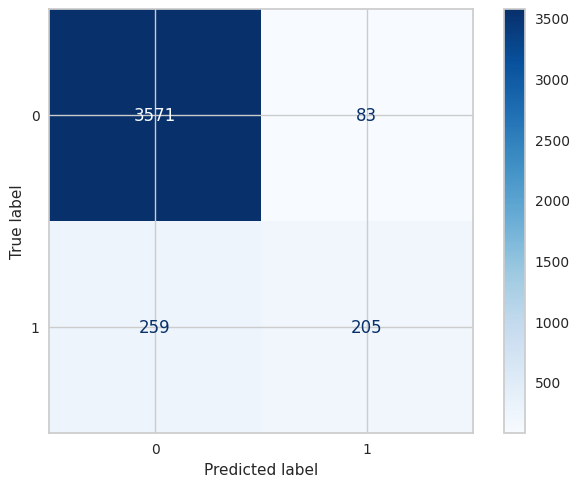

In [201]:
values_random = Check()

In [202]:
feature = SelectFeature(RandomForestClassifier(max_depth=10))

In [203]:
X_train = X_train.loc[:,feature]
X_test = X_test.loc[:,feature]

In [204]:
cross_validation(RandomForestClassifier(max_depth=10))

Cross Val Score : 0.9122678450223095


In [205]:
model=PipeLine(RandomForestClassifier(max_depth=10))
model

Pipeline(steps=[('scaling', MinMaxScaler()),
                ('model', RandomForestClassifier(max_depth=10))])

Model Train Score is :  0.9294041450777202
Model Test Score is :  0.9142787761049053
F1 Score is :  0.5721212121212121
Recall Score is :  0.5086206896551724
Precision Score is :  0.6537396121883656
AUC Value  :  0.7372058018609743


Classification Report is :                precision    recall  f1-score   support

           0       0.94      0.97      0.95      3654
           1       0.65      0.51      0.57       464

    accuracy                           0.91      4118
   macro avg       0.80      0.74      0.76      4118
weighted avg       0.91      0.91      0.91      4118

Confusion Matrix is : 
 [[3529  125]
 [ 228  236]]


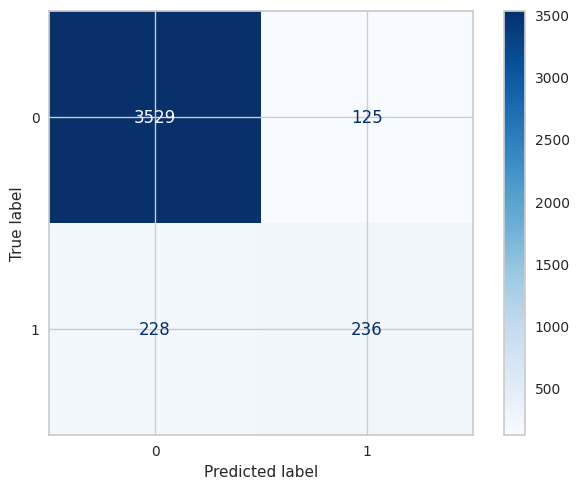

In [206]:
values_random_feature = Check()

    RandomOverSampler

In [207]:
X_train,y_train,X_test,y_test=Split(X_classification_over,y_classification_over)

X_train shape is  (65763, 20)
X_test shape is  (7307, 20)
y_train shape is  (65763,)
y_test shape is  (7307,)


In [208]:
Search(RandomForestClassifier(max_depth=20),{'max_depth':[20,25,30,35,40]})

RandomForestClassifier(max_depth=35)

In [209]:
cross_validation(RandomForestClassifier(max_depth=30))

Cross Val Score : 0.9635357292693904


In [210]:
model=PipeLine(RandomForestClassifier(max_depth=30))
model

Pipeline(steps=[('scaling', MinMaxScaler()),
                ('model', RandomForestClassifier(max_depth=30))])

Model Train Score is :  0.9999239694052887
Model Test Score is :  0.971944710551526
F1 Score is :  0.9726994273538421
Recall Score is :  0.9997262523952916
Precision Score is :  0.9470954356846473
AUC Value  :  0.9719485120761351


Classification Report is :                precision    recall  f1-score   support

           0       1.00      0.94      0.97      3654
           1       0.95      1.00      0.97      3653

    accuracy                           0.97      7307
   macro avg       0.97      0.97      0.97      7307
weighted avg       0.97      0.97      0.97      7307

Confusion Matrix is : 
 [[3450  204]
 [   1 3652]]


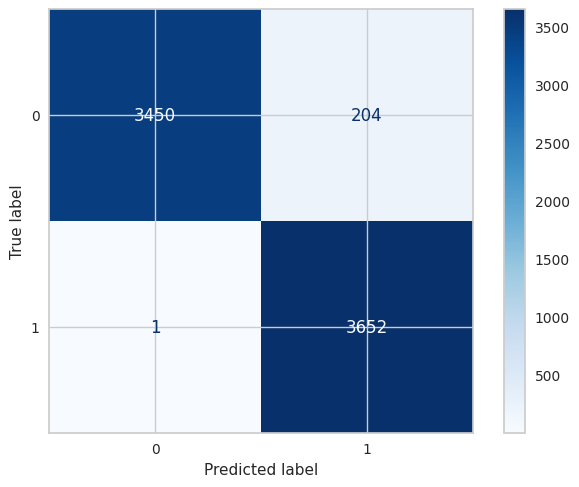

In [211]:
values_random_over = Check()

In [212]:
feature = SelectFeature(RandomForestClassifier(max_depth=30))

In [213]:
X_train = X_train.loc[:,feature]
X_test = X_test.loc[:,feature]

In [214]:
cross_validation(RandomForestClassifier(max_depth=30))

Cross Val Score : 0.9557197905966518


In [215]:
model=PipeLine(RandomForestClassifier(max_depth=30))
model

Pipeline(steps=[('scaling', MinMaxScaler()),
                ('model', RandomForestClassifier(max_depth=30))])

Model Train Score is :  0.9882456700576312
Model Test Score is :  0.9609963049130971
F1 Score is :  0.9624555394546174
Recall Score is :  1.0
Precision Score is :  0.9276282376841036
AUC Value  :  0.9610016420361248


Classification Report is :                precision    recall  f1-score   support

           0       1.00      0.92      0.96      3654
           1       0.93      1.00      0.96      3653

    accuracy                           0.96      7307
   macro avg       0.96      0.96      0.96      7307
weighted avg       0.96      0.96      0.96      7307

Confusion Matrix is : 
 [[3369  285]
 [   0 3653]]


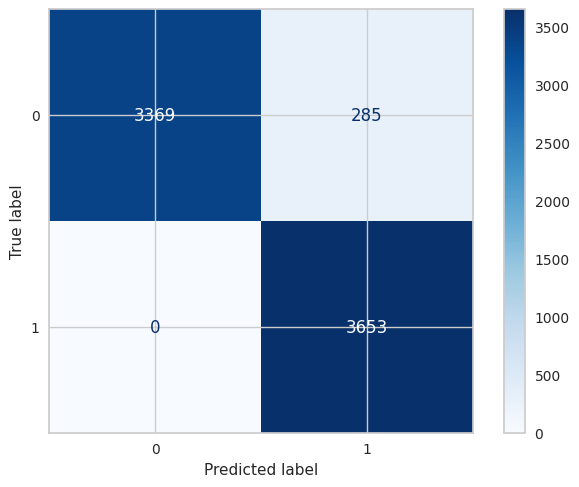

In [216]:
values_random_over_feature = Check()

    RandomUnderSampler

In [217]:
X_train,y_train,X_test,y_test=Split(X_classification_under,y_classification_under)

X_train shape is  (8350, 20)
X_test shape is  (928, 20)
y_train shape is  (8350,)
y_test shape is  (928,)


In [218]:
Search(RandomForestClassifier(max_depth=20),{'max_depth':[20,25,30,35,40]})

RandomForestClassifier(max_depth=35)

In [219]:
cross_validation(RandomForestClassifier(max_depth=25))

Cross Val Score : 0.8843113772455091


In [220]:
model=PipeLine(RandomForestClassifier(max_depth=25))
model

Pipeline(steps=[('scaling', MinMaxScaler()),
                ('model', RandomForestClassifier(max_depth=25))])

Model Train Score is :  1.0
Model Test Score is :  0.9127155172413793
F1 Score is :  0.9153605015673982
Recall Score is :  0.9439655172413793
Precision Score is :  0.8884381338742393
AUC Value  :  0.9127155172413793


Classification Report is :                precision    recall  f1-score   support

           0       0.94      0.88      0.91       464
           1       0.89      0.94      0.92       464

    accuracy                           0.91       928
   macro avg       0.91      0.91      0.91       928
weighted avg       0.91      0.91      0.91       928

Confusion Matrix is : 
 [[409  55]
 [ 26 438]]


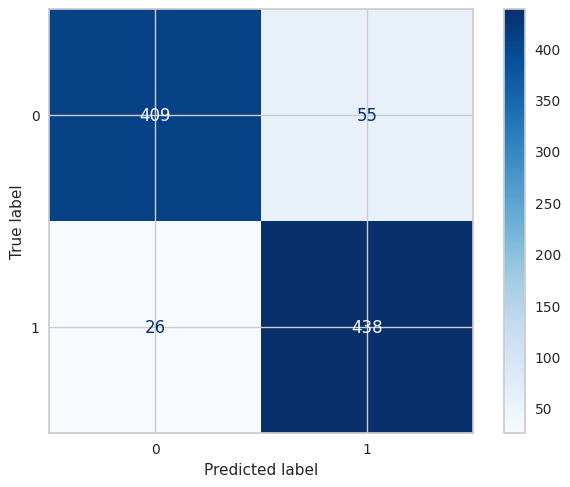

In [221]:
values_random_under = Check()

In [222]:
feature = SelectFeature(RandomForestClassifier(max_depth=25))

In [223]:
X_train = X_train.loc[:,feature]
X_test = X_test.loc[:,feature]

In [224]:
cross_validation(RandomForestClassifier(max_depth=25))

Cross Val Score : 0.8730538922155688


In [225]:
model=PipeLine(RandomForestClassifier(max_depth=25))
model

Pipeline(steps=[('scaling', MinMaxScaler()),
                ('model', RandomForestClassifier(max_depth=25))])

Model Train Score is :  0.988502994011976
Model Test Score is :  0.8890086206896551
F1 Score is :  0.8896034297963558
Recall Score is :  0.8943965517241379
Precision Score is :  0.8848614072494669
AUC Value  :  0.8890086206896551


Classification Report is :                precision    recall  f1-score   support

           0       0.89      0.88      0.89       464
           1       0.88      0.89      0.89       464

    accuracy                           0.89       928
   macro avg       0.89      0.89      0.89       928
weighted avg       0.89      0.89      0.89       928

Confusion Matrix is : 
 [[410  54]
 [ 49 415]]


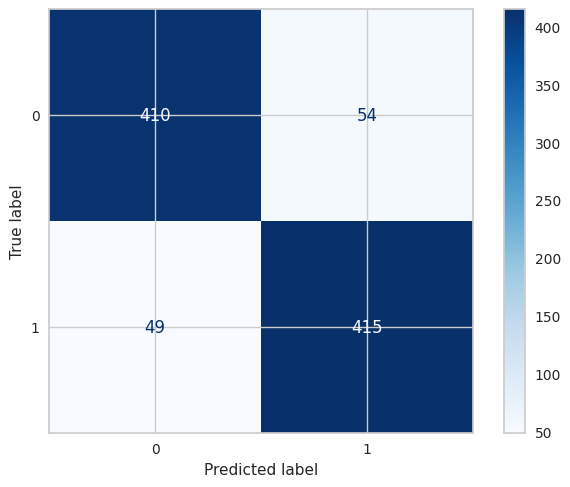

In [226]:
values_random_under_feature = Check()

In [227]:
list = [values_random,values_random_feature,values_random_over,values_random_over_feature,values_random_under,values_random_under_feature]
df = pd.DataFrame(list,columns=['Train Accuracy','Test Accuracy','Test F1','Test Recall','Test Precision','AUC'])
df['Models'] = ['Forest','Forest With Feature','Forest Over','Foresr Over With Feature','Forest Under','Forest Under With Feature']
df.set_index('Models', inplace=True)
df

,Train Accuracy,Test Accuracy,Test F1,Test Recall,Test Precision,AUC
Models,,,,,,
Forest,0.936151,0.916950,0.545213,0.441810,0.711806,0.709548
Forest With Feature,0.929404,0.914279,0.572121,0.508621,0.653740,0.737206
Forest Over,0.999924,0.971945,0.972699,0.999726,0.947095,0.971949
Foresr Over With Feature,0.988246,0.960996,0.962456,1.000000,0.927628,0.961002
Forest Under,1.000000,0.912716,0.915361,0.943966,0.888438,0.912716
Forest Under With Feature,0.988503,0.889009,0.889603,0.894397,0.884861,0.889009


In [228]:
models_draw(df)

    DecisionTreeClassifier

In [229]:
X_train,y_train,X_test,y_test=Split(X_classification,y_classification)

X_train shape is  (37056, 20)
X_test shape is  (4118, 20)
y_train shape is  (37056,)
y_test shape is  (4118,)


In [230]:
Search(DecisionTreeClassifier(max_depth=20),{'max_depth':[5,10,15,20,25,30,35,40]})

DecisionTreeClassifier(max_depth=5)

In [231]:
cross_validation(DecisionTreeClassifier(max_depth=5))

Cross Val Score : 0.9106757883786318


In [232]:
model=PipeLine(DecisionTreeClassifier(max_depth=5))
model

Pipeline(steps=[('scaling', MinMaxScaler()),
                ('model', DecisionTreeClassifier(max_depth=5))])

Model Train Score is :  0.9131854490500864
Model Test Score is :  0.9150072850898494
F1 Score is :  0.6128318584070797
Recall Score is :  0.5969827586206896
Precision Score is :  0.6295454545454545
AUC Value  :  0.7761870552818828


Classification Report is :                precision    recall  f1-score   support

           0       0.95      0.96      0.95      3654
           1       0.63      0.60      0.61       464

    accuracy                           0.92      4118
   macro avg       0.79      0.78      0.78      4118
weighted avg       0.91      0.92      0.91      4118

Confusion Matrix is : 
 [[3491  163]
 [ 187  277]]


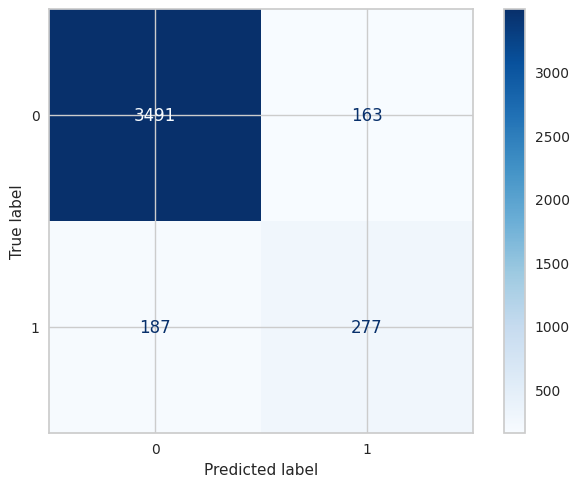

In [233]:
values_decision = Check()

In [234]:
feature = SelectFeature(DecisionTreeClassifier(max_depth=5))

In [235]:
X_train = X_train.loc[:,feature]
X_test = X_test.loc[:,feature]

In [236]:
cross_validation(DecisionTreeClassifier(max_depth=5))

Cross Val Score : 0.9060611029986128


In [237]:
model=PipeLine(DecisionTreeClassifier(max_depth=5))
model

Pipeline(steps=[('scaling', MinMaxScaler()),
                ('model', DecisionTreeClassifier(max_depth=5))])

Model Train Score is :  0.9078961571675302
Model Test Score is :  0.9094220495386109
F1 Score is :  0.60021436227224
Recall Score is :  0.603448275862069
Precision Score is :  0.5970149253731343
AUC Value  :  0.7758620689655172


Classification Report is :                precision    recall  f1-score   support

           0       0.95      0.95      0.95      3654
           1       0.60      0.60      0.60       464

    accuracy                           0.91      4118
   macro avg       0.77      0.78      0.77      4118
weighted avg       0.91      0.91      0.91      4118

Confusion Matrix is : 
 [[3465  189]
 [ 184  280]]


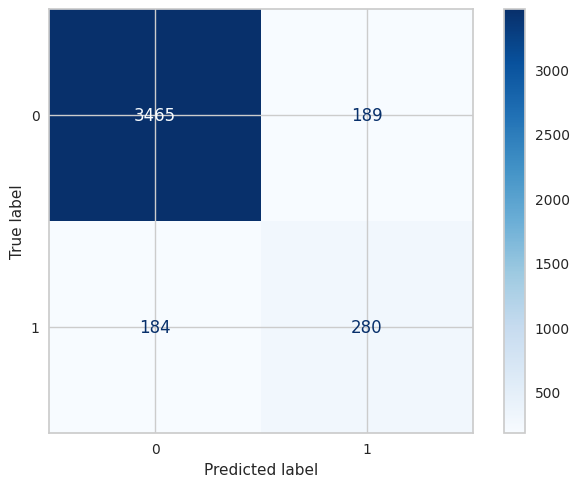

In [238]:
values_decision_feature = Check()

    RandomOverSampler

In [239]:
X_train,y_train,X_test,y_test=Split(X_classification_over,y_classification_over)

X_train shape is  (65763, 20)
X_test shape is  (7307, 20)
y_train shape is  (65763,)
y_test shape is  (7307,)


In [240]:
Search(DecisionTreeClassifier(max_depth=20),{'max_depth':[20,25,30,35,40]})

DecisionTreeClassifier(max_depth=40)

In [241]:
cross_validation(DecisionTreeClassifier(max_depth=35))

Cross Val Score : 0.9635965241478589


In [242]:
model=PipeLine(DecisionTreeClassifier(max_depth=35))
model

Pipeline(steps=[('scaling', MinMaxScaler()),
                ('model', DecisionTreeClassifier(max_depth=35))])

Model Train Score is :  0.9999239694052887
Model Test Score is :  0.9683864787190365
F1 Score is :  0.9693430656934306
Recall Score is :  0.9997262523952916
Precision Score is :  0.9407521895929933
AUC Value  :  0.9683907671390799


Classification Report is :                precision    recall  f1-score   support

           0       1.00      0.94      0.97      3654
           1       0.94      1.00      0.97      3653

    accuracy                           0.97      7307
   macro avg       0.97      0.97      0.97      7307
weighted avg       0.97      0.97      0.97      7307

Confusion Matrix is : 
 [[3424  230]
 [   1 3652]]


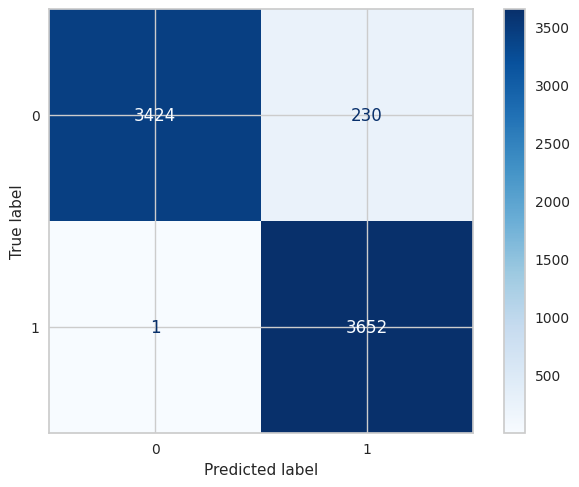

In [243]:
values_decision_over = Check()

In [244]:
feature = SelectFeature(DecisionTreeClassifier(max_depth=35))

In [245]:
X_train = X_train.loc[:,feature]
X_test = X_test.loc[:,feature]

In [246]:
cross_validation(DecisionTreeClassifier(max_depth=35))

Cross Val Score : 0.9579094768144261


In [247]:
model=PipeLine(DecisionTreeClassifier(max_depth=35))
model

Pipeline(steps=[('scaling', MinMaxScaler()),
                ('model', DecisionTreeClassifier(max_depth=35))])

Model Train Score is :  0.989218861669936
Model Test Score is :  0.9622280005474203
F1 Score is :  0.9635979952519125
Recall Score is :  1.0
Precision Score is :  0.92975311784169
AUC Value  :  0.9622331691297208


Classification Report is :                precision    recall  f1-score   support

           0       1.00      0.92      0.96      3654
           1       0.93      1.00      0.96      3653

    accuracy                           0.96      7307
   macro avg       0.96      0.96      0.96      7307
weighted avg       0.96      0.96      0.96      7307

Confusion Matrix is : 
 [[3378  276]
 [   0 3653]]


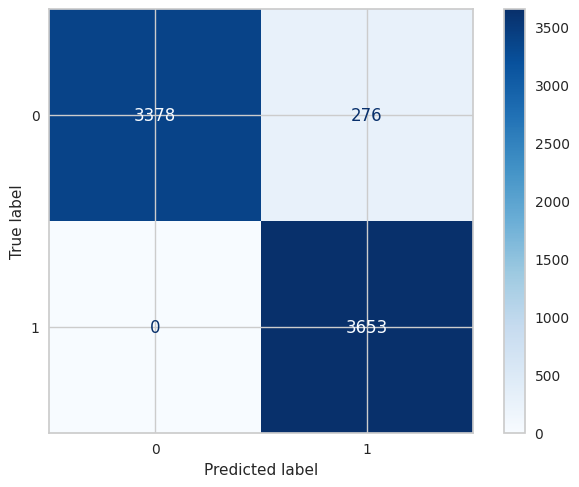

In [248]:
values_decision_over_feature = Check()

    RandomUnderSampler

In [249]:
X_train,y_train,X_test,y_test=Split(X_classification_under,y_classification_under)

X_train shape is  (8350, 20)
X_test shape is  (928, 20)
y_train shape is  (8350,)
y_test shape is  (928,)


In [250]:
Search(DecisionTreeClassifier(max_depth=20),{'max_depth':[20,25,30,35,40]})

DecisionTreeClassifier(max_depth=40)

In [251]:
cross_validation(DecisionTreeClassifier(max_depth=40))

Cross Val Score : 0.828862275449102


In [252]:
model=PipeLine(DecisionTreeClassifier(max_depth=40))
model

Pipeline(steps=[('scaling', MinMaxScaler()),
                ('model', DecisionTreeClassifier(max_depth=40))])

Model Train Score is :  1.0
Model Test Score is :  0.8491379310344828
F1 Score is :  0.8458149779735683
Recall Score is :  0.8275862068965517
Precision Score is :  0.8648648648648649
AUC Value  :  0.8491379310344828


Classification Report is :                precision    recall  f1-score   support

           0       0.83      0.87      0.85       464
           1       0.86      0.83      0.85       464

    accuracy                           0.85       928
   macro avg       0.85      0.85      0.85       928
weighted avg       0.85      0.85      0.85       928

Confusion Matrix is : 
 [[404  60]
 [ 80 384]]


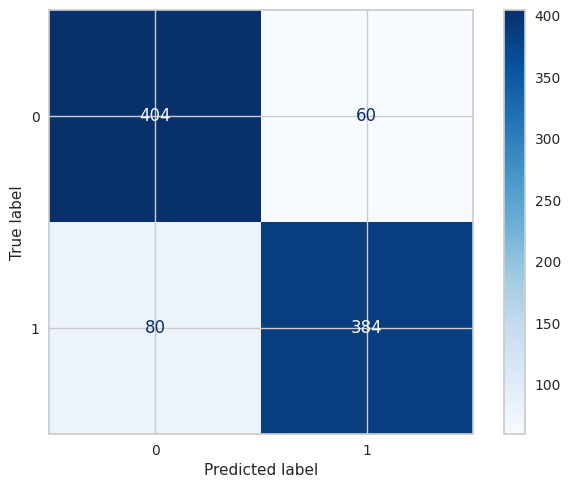

In [253]:
values_decision_under = Check()

In [254]:
feature = SelectFeature(DecisionTreeClassifier(max_depth=40))

In [255]:
X_train = X_train.loc[:,feature]
X_test = X_test.loc[:,feature]

In [256]:
cross_validation(DecisionTreeClassifier(max_depth=40))

Cross Val Score : 0.8306586826347304


In [257]:
model=PipeLine(DecisionTreeClassifier(max_depth=40))
model

Pipeline(steps=[('scaling', MinMaxScaler()),
                ('model', DecisionTreeClassifier(max_depth=40))])

Model Train Score is :  0.9895808383233533
Model Test Score is :  0.8232758620689655
F1 Score is :  0.8177777777777778
Recall Score is :  0.7931034482758621
Precision Score is :  0.8440366972477065
AUC Value  :  0.8232758620689655


Classification Report is :                precision    recall  f1-score   support

           0       0.80      0.85      0.83       464
           1       0.84      0.79      0.82       464

    accuracy                           0.82       928
   macro avg       0.82      0.82      0.82       928
weighted avg       0.82      0.82      0.82       928

Confusion Matrix is : 
 [[396  68]
 [ 96 368]]


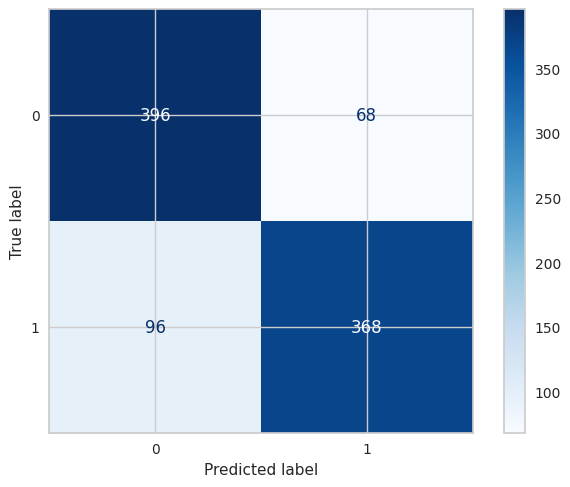

In [258]:
values_decision_under_feature = Check()

In [259]:
list = [values_decision,values_decision_feature,values_decision_over,values_decision_over_feature,values_decision_under,values_decision_under_feature]
df = pd.DataFrame(list,columns=['Train Accuracy','Test Accuracy','Test F1','Test Recall','Test Precision','AUC'])
df['Models'] = ['Decision','Decision With Feature','Decision Over','Decision Over With Feature','Decision Under','Decision Under With Feature']
df.set_index('Models', inplace=True)
df

,Train Accuracy,Test Accuracy,Test F1,Test Recall,Test Precision,AUC
Models,,,,,,
Decision,0.913185,0.915007,0.612832,0.596983,0.629545,0.776187
Decision With Feature,0.907896,0.909422,0.600214,0.603448,0.597015,0.775862
Decision Over,0.999924,0.968386,0.969343,0.999726,0.940752,0.968391
Decision Over With Feature,0.989219,0.962228,0.963598,1.000000,0.929753,0.962233
Decision Under,1.000000,0.849138,0.845815,0.827586,0.864865,0.849138
Decision Under With Feature,0.989581,0.823276,0.817778,0.793103,0.844037,0.823276


In [260]:
models_draw(df)

    KNeighborsClassifier

In [261]:
X_train,y_train,X_test,y_test=Split(X_classification,y_classification)

X_train shape is  (37056, 20)
X_test shape is  (4118, 20)
y_train shape is  (37056,)
y_test shape is  (4118,)


In [262]:
Search(KNeighborsClassifier(n_neighbors=3),{'n_neighbors':[3,5,7,9,11]})

KNeighborsClassifier(n_neighbors=11)

In [263]:
cross_validation(KNeighborsClassifier(n_neighbors=11))

Cross Val Score : 0.9070595641038544


In [264]:
model=PipeLine(KNeighborsClassifier(n_neighbors=11))
model

Pipeline(steps=[('scaling', MinMaxScaler()),
                ('model', KNeighborsClassifier(n_neighbors=11))])

Model Train Score is :  0.9137521588946459
Model Test Score is :  0.8987372510927635
F1 Score is :  0.3912408759124087
Recall Score is :  0.28879310344827586
Precision Score is :  0.6063348416289592
AUC Value  :  0.6324917898193759


Classification Report is :                precision    recall  f1-score   support

           0       0.92      0.98      0.94      3654
           1       0.61      0.29      0.39       464

    accuracy                           0.90      4118
   macro avg       0.76      0.63      0.67      4118
weighted avg       0.88      0.90      0.88      4118

Confusion Matrix is : 
 [[3567   87]
 [ 330  134]]


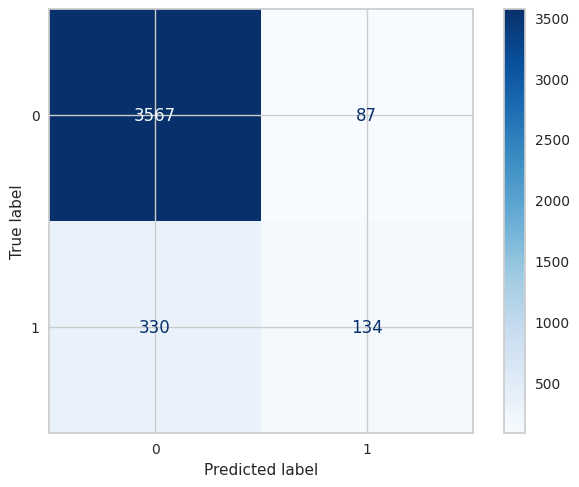

In [265]:
values_knn = Check()

    RandomOverSampler

In [266]:
X_train,y_train,X_test,y_test=Split(X_classification_over,y_classification_over)

X_train shape is  (65763, 20)
X_test shape is  (7307, 20)
y_train shape is  (65763,)
y_test shape is  (7307,)


In [267]:
Search(KNeighborsClassifier(n_neighbors=3),{'n_neighbors':[3,5,7,9,11]})

KNeighborsClassifier(n_neighbors=3)

In [268]:
cross_validation(KNeighborsClassifier(n_neighbors=3))

Cross Val Score : 0.9382935937570236


In [269]:
model=PipeLine(KNeighborsClassifier(n_neighbors=3))
model

Pipeline(steps=[('scaling', MinMaxScaler()),
                ('model', KNeighborsClassifier(n_neighbors=3))])

Model Train Score is :  0.9664248893754847
Model Test Score is :  0.9458053920897769
F1 Score is :  0.9484374999999999
Recall Score is :  0.9969887763482069
Precision Score is :  0.904395331512292
AUC Value  :  0.9458123958369388


Classification Report is :                precision    recall  f1-score   support

           0       1.00      0.89      0.94      3654
           1       0.90      1.00      0.95      3653

    accuracy                           0.95      7307
   macro avg       0.95      0.95      0.95      7307
weighted avg       0.95      0.95      0.95      7307

Confusion Matrix is : 
 [[3269  385]
 [  11 3642]]


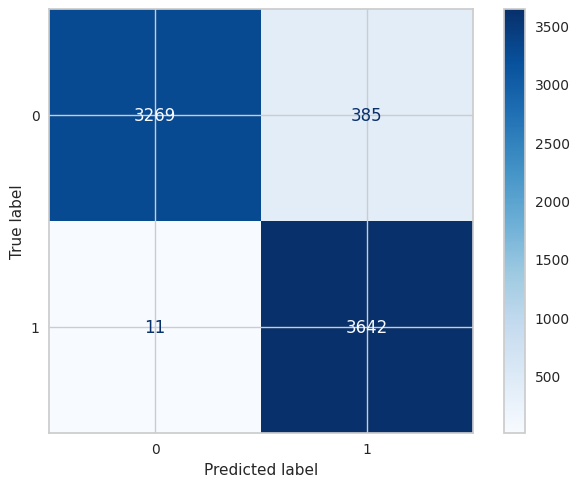

In [270]:
values_knn_over = Check()

    RandomUnderSampler

In [271]:
X_train,y_train,X_test,y_test=Split(X_classification_under,y_classification_under)

X_train shape is  (8350, 20)
X_test shape is  (928, 20)
y_train shape is  (8350,)
y_test shape is  (928,)


In [272]:
Search(KNeighborsClassifier(n_neighbors=3),{'n_neighbors':[3,5,7,9,11]})

KNeighborsClassifier(n_neighbors=11)

In [273]:
cross_validation(KNeighborsClassifier(n_neighbors=11))

Cross Val Score : 0.8622754491017964


In [274]:
model=PipeLine(KNeighborsClassifier(n_neighbors=11))
model

Pipeline(steps=[('scaling', MinMaxScaler()),
                ('model', KNeighborsClassifier(n_neighbors=11))])

Model Train Score is :  0.8704191616766467
Model Test Score is :  0.8556034482758621
F1 Score is :  0.8598326359832636
Recall Score is :  0.8857758620689655
Precision Score is :  0.8353658536585366
AUC Value  :  0.8556034482758621


Classification Report is :                precision    recall  f1-score   support

           0       0.88      0.83      0.85       464
           1       0.84      0.89      0.86       464

    accuracy                           0.86       928
   macro avg       0.86      0.86      0.86       928
weighted avg       0.86      0.86      0.86       928

Confusion Matrix is : 
 [[383  81]
 [ 53 411]]


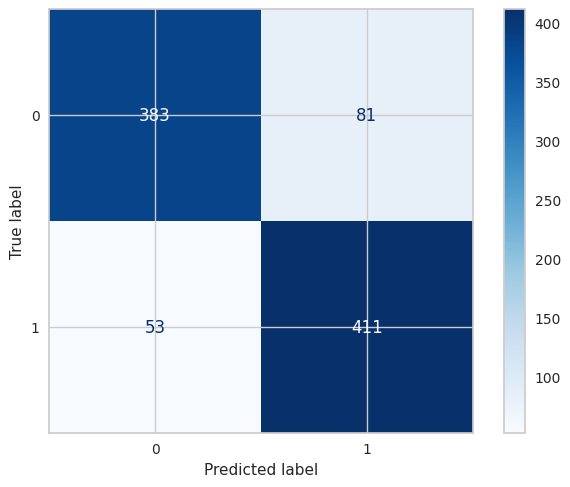

In [275]:
values_knn_under = Check()

In [276]:
list = [values_knn,values_knn_over,values_knn_under]
df = pd.DataFrame(list,columns=['Train Accuracy','Test Accuracy','Test F1','Test Recall','Test Precision','AUC'])
df['Models'] = ['KNN','KNN Over','KNN Under']
df.set_index('Models', inplace=True)
df

,Train Accuracy,Test Accuracy,Test F1,Test Recall,Test Precision,AUC
Models,,,,,,
KNN,0.913752,0.898737,0.391241,0.288793,0.606335,0.632492
KNN Over,0.966425,0.945805,0.948437,0.996989,0.904395,0.945812
KNN Under,0.870419,0.855603,0.859833,0.885776,0.835366,0.855603


In [277]:
models_draw(df)

> Regression

    LinearRegression

In [278]:
def Check_R():
    y_pred = model.predict(X_test)
    print('R2 Score Train :',r2_score(y_train,model.predict(X_train)))
    print('R2 Score Test :',r2_score(y_test,y_pred))
    MAEValue = mean_absolute_error(y_test, y_pred)
    print('Mean Absolute Error Value is : ', MAEValue)
    MSEValue = mean_squared_error(y_test, y_pred)
    print('Mean Squared Error Value is : ', MSEValue)
    MdSEValue = median_absolute_error(y_test, y_pred)
    print('Median Absolute Error Value is : ', MdSEValue )
    return [r2_score(y_train,model.predict(X_train)),r2_score(y_test,y_pred),MAEValue,MSEValue,MdSEValue]
def PipeLine2(model):
    steps = [
    ('poly',PolynomialFeatures(degree=3)),
    ('scaling', MinMaxScaler()),
    ('model', model)
    ]
    return Pipeline(steps).fit(X_train,y_train)

In [279]:
X_train,y_train,X_test,y_test=Split(X_regression,y_regression,classification=0)

X_train shape is  (37056, 20)
X_test shape is  (4118, 20)
y_train shape is  (37056,)
y_test shape is  (4118,)


In [280]:
cross_validation(LinearRegression())

Cross Val Score : 0.1782134355129124


In [281]:
model=PipeLine(LinearRegression())
model

Pipeline(steps=[('scaling', MinMaxScaler()), ('model', LinearRegression())])

In [282]:
value_R = Check_R()

R2 Score Train : 0.179324105446396
R2 Score Test : 0.17319991396970325
Mean Absolute Error Value is :  0.19616106192022842
Mean Squared Error Value is :  0.06183559491913678
Median Absolute Error Value is :  0.16705067346059804


In [283]:
feature = SelectFeature(LinearRegression())

In [284]:
X_train = X_train.loc[:,feature]
X_test = X_test.loc[:,feature]

In [285]:
cross_validation(LinearRegression())

Cross Val Score : 0.16139720514809316


In [286]:
model=PipeLine(LinearRegression())
model

Pipeline(steps=[('scaling', MinMaxScaler()), ('model', LinearRegression())])

In [287]:
value_R_feature = Check_R()

R2 Score Train : 0.16159771203946838
R2 Score Test : 0.15552902340966757
Mean Absolute Error Value is :  0.1991462485274703
Mean Squared Error Value is :  0.06315718407834585
Median Absolute Error Value is :  0.16925465838509318


    PolynomialFeatures

In [288]:
X_train,y_train,X_test,y_test=Split(X_regression,y_regression,classification=0)

X_train shape is  (37056, 20)
X_test shape is  (4118, 20)
y_train shape is  (37056,)
y_test shape is  (4118,)


In [289]:
model=PipeLine2(LinearRegression())
model

Pipeline(steps=[('poly', PolynomialFeatures(degree=3)),
                ('scaling', MinMaxScaler()), ('model', LinearRegression())])

In [290]:
value_R_poly = Check_R()

R2 Score Train : 0.28098545334471325
R2 Score Test : 0.18958234589921685
Mean Absolute Error Value is :  0.18951245563159752
Mean Squared Error Value is :  0.06061036835989981
Median Absolute Error Value is :  0.1538851957143464


In [291]:
feature = SelectFeature(LinearRegression())

In [292]:
X_train = X_train.loc[:,feature]
X_test = X_test.loc[:,feature]

In [293]:
model=PipeLine2(LinearRegression())
model

Pipeline(steps=[('poly', PolynomialFeatures(degree=3)),
                ('scaling', MinMaxScaler()), ('model', LinearRegression())])

In [294]:
value_R_poly_feature = Check_R()

R2 Score Train : 0.16159673934459484
R2 Score Test : 0.155556817123239
Mean Absolute Error Value is :  0.1991670162852016
Mean Squared Error Value is :  0.06315510541284648
Median Absolute Error Value is :  0.16925465838509318


In [295]:
list = [value_R,value_R_feature,value_R_poly,value_R_poly_feature]
df = pd.DataFrame(list,columns=['Train Accuracy','Test Accuracy','MAE','MSE','MdSE'])
df['Models'] = ['Linear','Linear With Feature','Linear With Poly','Linear with Poly and Feature']
df.set_index('Models', inplace=True)
df

,Train Accuracy,Test Accuracy,MAE,MSE,MdSE
Models,,,,,
Linear,0.179324,0.173200,0.196161,0.061836,0.167051
Linear With Feature,0.161598,0.155529,0.199146,0.063157,0.169255
Linear With Poly,0.280985,0.189582,0.189512,0.060610,0.153885
Linear with Poly and Feature,0.161597,0.155557,0.199167,0.063155,0.169255


In [296]:
models_draw(df)

    RandomForestRegressor

In [297]:
X_train,y_train,X_test,y_test=Split(X_regression,y_regression,classification=0)

X_train shape is  (37056, 20)
X_test shape is  (4118, 20)
y_train shape is  (37056,)
y_test shape is  (4118,)


In [298]:
Search(RandomForestRegressor(max_depth=20),{'max_depth':[20,25,30,35,40]})

RandomForestRegressor(max_depth=20)

In [299]:
cross_validation(RandomForestRegressor(max_depth=20))

Cross Val Score : 0.19958876474971227


In [300]:
model=PipeLine(RandomForestRegressor(max_depth=20))
model

Pipeline(steps=[('scaling', MinMaxScaler()),
                ('model', RandomForestRegressor(max_depth=20))])

In [301]:
value_FR = Check_R()

R2 Score Train : 0.7144455697069918
R2 Score Test : 0.1649778967540969
Mean Absolute Error Value is :  0.194195406435958
Mean Squared Error Value is :  0.062450511795117576
Median Absolute Error Value is :  0.158379711429637


In [302]:
feature = SelectFeature(RandomForestRegressor(max_depth=20))

In [303]:
X_train = X_train.loc[:,feature]
X_test = X_test.loc[:,feature]

In [304]:
cross_validation(RandomForestRegressor(max_depth=20))

Cross Val Score : 0.15401656427465055


In [305]:
model=PipeLine(RandomForestRegressor(max_depth=20))
model

Pipeline(steps=[('scaling', MinMaxScaler()),
                ('model', RandomForestRegressor(max_depth=20))])

In [306]:
value_FR_feature = Check_R()

R2 Score Train : 0.6912202213027029
R2 Score Test : 0.12253209850094038
Mean Absolute Error Value is :  0.1981816584223667
Mean Squared Error Value is :  0.06562499282281478
Median Absolute Error Value is :  0.1614455528024608


    PolynomialFeatures

In [307]:
X_train,y_train,X_test,y_test=Split(X_regression,y_regression,classification=0)

X_train shape is  (37056, 20)
X_test shape is  (4118, 20)
y_train shape is  (37056,)
y_test shape is  (4118,)


In [308]:
model=PipeLine(RandomForestRegressor(max_depth=20))
model

Pipeline(steps=[('scaling', MinMaxScaler()),
                ('model', RandomForestRegressor(max_depth=20))])

In [309]:
value_FR_poly = Check_R()

R2 Score Train : 0.7234016813295254
R2 Score Test : 0.16655677616741427
Mean Absolute Error Value is :  0.19437014596671934
Mean Squared Error Value is :  0.06233242890001676
Median Absolute Error Value is :  0.15887773314145154


In [310]:
feature = SelectFeature(RandomForestRegressor(max_depth=20))

In [311]:
X_train = X_train.loc[:,feature]
X_test = X_test.loc[:,feature]

In [312]:
model=PipeLine(RandomForestRegressor(max_depth=20))
model

Pipeline(steps=[('scaling', MinMaxScaler()),
                ('model', RandomForestRegressor(max_depth=20))])

In [313]:
value_FR_poly_feature = Check_R()

R2 Score Train : 0.6895649534579491
R2 Score Test : 0.12646344072772187
Mean Absolute Error Value is :  0.19794115065367116
Mean Squared Error Value is :  0.06533097146320059
Median Absolute Error Value is :  0.16075876068776357


In [314]:
list = [value_FR,value_FR_feature,value_FR_poly,value_FR_poly_feature]
df = pd.DataFrame(list,columns=['Train Accuracy','Test Accuracy','MAE','MSE','MdSE'])
df['Models'] = ['Random','Random With Feature','Random With Poly','Random With Poly and Feature']
df.set_index('Models', inplace=True)
df

,Train Accuracy,Test Accuracy,MAE,MSE,MdSE
Models,,,,,
Random,0.714446,0.164978,0.194195,0.062451,0.158380
Random With Feature,0.691220,0.122532,0.198182,0.065625,0.161446
Random With Poly,0.723402,0.166557,0.194370,0.062332,0.158878
Random With Poly and Feature,0.689565,0.126463,0.197941,0.065331,0.160759


In [315]:
models_draw(df)

    Ridge

In [316]:
X_train,y_train,X_test,y_test=Split(X_regression,y_regression,classification=0)

X_train shape is  (37056, 20)
X_test shape is  (4118, 20)
y_train shape is  (37056,)
y_test shape is  (4118,)


In [317]:
Search(Ridge(alpha=1.0),{'alpha':[1,2,.5,5,10,15,40]})

Ridge(alpha=0.5)

In [318]:
model=PipeLine(Ridge(alpha=.5))
model

Pipeline(steps=[('scaling', MinMaxScaler()), ('model', Ridge(alpha=0.5))])

In [319]:
value_Ri = Check_R()

R2 Score Train : 0.17932330017019849
R2 Score Test : 0.17319828889615962
Mean Absolute Error Value is :  0.19616402049447035
Mean Squared Error Value is :  0.06183571645684711
Median Absolute Error Value is :  0.166997684740472


In [320]:
feature = SelectFeature(Ridge(alpha=.5))

In [321]:
X_train = X_train.loc[:,feature]
X_test = X_test.loc[:,feature]

In [322]:
model=PipeLine(Ridge(alpha=.5))
model

Pipeline(steps=[('scaling', MinMaxScaler()), ('model', Ridge(alpha=0.5))])

In [323]:
value_Ri_feature = Check_R()

R2 Score Train : 0.16159711401530252
R2 Score Test : 0.1555307384782424
Mean Absolute Error Value is :  0.19914689903751662
Mean Squared Error Value is :  0.06315705580999241
Median Absolute Error Value is :  0.16925465838509318


    PolynomialFeaturesl

In [324]:
X_train,y_train,X_test,y_test=Split(X_regression,y_regression,classification=0)

X_train shape is  (37056, 20)
X_test shape is  (4118, 20)
y_train shape is  (37056,)
y_test shape is  (4118,)


In [325]:
model=PipeLine2(Ridge(alpha=.5))
model

Pipeline(steps=[('poly', PolynomialFeatures(degree=3)),
                ('scaling', MinMaxScaler()), ('model', Ridge(alpha=0.5))])

In [326]:
value_Ri_poly = Check_R()

R2 Score Train : 0.2603108044013065
R2 Score Test : 0.21599758119690282
Mean Absolute Error Value is :  0.18759805922484615
Mean Squared Error Value is :  0.05863479794431866
Median Absolute Error Value is :  0.15416507066622692


In [327]:
feature = SelectFeature(Ridge(alpha=.5))

In [328]:
X_train = X_train.loc[:,feature]
X_test = X_test.loc[:,feature]

In [329]:
model=PipeLine2(Ridge(alpha=.5))
model

Pipeline(steps=[('poly', PolynomialFeatures(degree=3)),
                ('scaling', MinMaxScaler()), ('model', Ridge(alpha=0.5))])

In [330]:
value_Ri_poly_feaure = Check_R()

R2 Score Train : 0.1615976309385776
R2 Score Test : 0.15552960040832475
Mean Absolute Error Value is :  0.19914644795749847
Mean Squared Error Value is :  0.06315714092516307
Median Absolute Error Value is :  0.16925465838509318


In [331]:
list = [value_Ri,value_Ri_feature,value_Ri_poly,value_Ri_poly_feaure]
df = pd.DataFrame(list,columns=['Train Accuracy','Test Accuracy','MAE','MSE','MdSE'])
df['Models'] = ['Ridge','Ridge With Feature','Ridge With Poly','Ridge With Poly and Feature']
df.set_index('Models', inplace=True)
df

,Train Accuracy,Test Accuracy,MAE,MSE,MdSE
Models,,,,,
Ridge,0.179323,0.173198,0.196164,0.061836,0.166998
Ridge With Feature,0.161597,0.155531,0.199147,0.063157,0.169255
Ridge With Poly,0.260311,0.215998,0.187598,0.058635,0.154165
Ridge With Poly and Feature,0.161598,0.155530,0.199146,0.063157,0.169255


In [332]:
models_draw(df)

> Clustering

**Feature Scaling**

In [333]:
Columns = X_cluster.columns

In [334]:
MS = MinMaxScaler()
X_cluster = MS.fit_transform(X_cluster)

In [335]:
X_cluster = pd.DataFrame(X_cluster,columns=Columns)
X_cluster.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,0.750000,0.3,0.5,0.000000,0.0,0.0,0.0,1.0,0.666667,0.25,...,0.0,1.0,0.0,0.5,0.9375,0.698753,0.603774,0.957379,0.859735,0.0
1,0.769231,0.7,0.5,0.500000,0.0,0.0,0.0,1.0,0.666667,0.25,...,0.0,1.0,0.0,0.5,0.9375,0.698753,0.603774,0.957379,0.859735,0.0
2,0.384615,0.7,0.5,0.500000,0.0,1.0,0.0,1.0,0.666667,0.25,...,0.0,1.0,0.0,0.5,0.9375,0.698753,0.603774,0.957379,0.859735,0.0
3,0.442308,0.0,0.5,0.166667,0.0,0.0,0.0,1.0,0.666667,0.25,...,0.0,1.0,0.0,0.5,0.9375,0.698753,0.603774,0.957379,0.859735,0.0
4,0.750000,0.7,0.5,0.500000,0.0,0.0,1.0,1.0,0.666667,0.25,...,0.0,1.0,0.0,0.5,0.9375,0.698753,0.603774,0.957379,0.859735,0.0


In [336]:
X_train,X_test=Split(X_cluster,classification=2)

X_train shape is  (37056, 21)
X_test shape is  (4118, 21)


    PCA

In [337]:
PCAModel = PCA(n_components=2, svd_solver='auto')
PCAModel.fit(X_train.iloc[:,:-1])
print('PCAModel Train Score is : ' , PCAModel.score(X_train.iloc[:,:-1]))
print('PCAModel Test Score is : ' , PCAModel.score(X_test.iloc[:,:-1]))
print('PCAModel Score Samples is : ' , PCAModel.score_samples(X_test.iloc[:,:-1]))
print('PCAModel No. of components is : ' , PCAModel.components_)
print('PCAModel Explained Variance is : ' , PCAModel.explained_variance_)
print('PCAModel Explained Variance ratio is : ' , PCAModel.explained_variance_ratio_)

PCAModel Train Score is :  -2.557996267373243
PCAModel Test Score is :  -2.5556440654556227
PCAModel Score Samples is :  [ 1.57658514  1.17360854 -1.66335182 ...  3.62654311 -1.61569019
  0.52253459]
PCAModel No. of components is :  [[-1.10829341e-02  2.43273396e-02  5.59442196e-02  5.97238289e-02
  -1.32325962e-05  1.37595647e-01  7.37131667e-03 -5.15882762e-01
   1.42736001e-03 -1.43961456e-02  2.62369563e-02 -8.03371291e-02
  -7.81601874e-02  4.67425668e-02 -5.42175308e-02 -4.48157492e-01
  -2.72625789e-01 -8.10211028e-02 -5.41444945e-01 -3.37616035e-01]
 [-1.12117285e-03 -7.55920715e-03  5.10793187e-03 -1.52325175e-02
   4.61955595e-05 -9.80892735e-01 -5.54849935e-02  2.17348172e-02
   4.08101524e-02 -1.38567492e-02  1.66700115e-02 -2.23631315e-02
  -2.22152847e-02  1.12947765e-02 -8.87762707e-03 -9.53515825e-02
  -2.71895192e-02 -3.15361363e-03 -1.15937854e-01 -8.58127505e-02]]
PCAModel Explained Variance is :  [0.43965034 0.24519807]
PCAModel Explained Variance ratio is :  [0.238

In [338]:
X_train_pca = PCAModel.transform(X_train.iloc[:,:-1])
X_test_pca = PCAModel.transform(X_test.iloc[:,:-1])
X_train_pca = pd.DataFrame(X_train_pca,columns=['Feature1','Feature2'])
X_test_pca = pd.DataFrame(X_test_pca,columns=['Feature1','Feature2'])
X_train_pca.head()

,Feature1,Feature2
0,1.112444,-0.342671
1,-0.109978,-0.540637
2,-0.771642,0.436251
3,-0.558836,-0.462642
4,0.762603,0.678327


In [339]:
X_train.reset_index(inplace=True)
X_test.reset_index(inplace=True)

In [340]:
fig = go.Figure()
for color,y_ in zip(['red','orange'],X_train.y.unique()):
    pca = X_train_pca[X_train.y==y_]
    scatter_trace = go.Scatter(
        x=pca['Feature1'],
        y=pca['Feature2'],
        mode='markers', 
        marker=dict(
            size=20, 
            color=color,  
            symbol='circle', 
            opacity=0.8  
        ),
        name=f'Train Cluster {y_}'
    )
    fig.add_trace(scatter_trace)
for color,y_ in zip(['green','blue'],X_test.y.unique()):
    pca = X_test_pca[X_test.y==y_]
    scatter_trace = go.Scatter(
        x=pca['Feature1'],
        y=pca['Feature2'],
        mode='markers', 
        marker=dict(
            size=10, 
            color=color,  
            symbol='circle', 
            opacity=0.8  
        ),
        name=f'Test Cluster {y_}'
    )
    fig.add_trace(scatter_trace)
fig.update_layout(
    title_text='PCA',
    title_x=0.5,
    title_font=dict(size=20),
    xaxis_title='Feature1',
    yaxis_title='Feature2',
    font=dict(size=15),
    width=1000,
    height=700,
    xaxis=dict(tickangle=-90),
    template='plotly_dark'
)
fig.update_annotations(font=dict(size=20))
fig.show()

**K-Means model with two clusters** 

In [341]:
kmeans1 = KMeans(n_clusters=2,random_state=44)
kmeans1.fit(X_train.iloc[:,:-1])

KMeans(n_clusters=2, random_state=44)

In [342]:
kmeans1.cluster_centers_

array([[ 3.08556103e+04,  4.40855528e-01,  3.77643750e-01,
         6.04478823e-01,  6.60554263e-01,  1.62276194e-04,
         5.92037648e-01,  1.54757397e-01,  9.24433386e-02,
         4.76484977e-01,  4.96740953e-01,  3.63626429e-01,
         2.23984421e-01,  9.27952943e-01,  4.94092374e-02,
         4.28841889e-01,  4.75505310e-01,  3.62225108e-01,
         3.91442499e-01,  3.84627531e-01,  5.92017688e-01],
       [ 1.02762860e+04,  4.41469861e-01,  3.48317088e-01,
         5.64543056e-01,  5.74335362e-01, -2.71050543e-19,
         5.06866283e-01,  1.50573537e-01,  6.39237439e-01,
         4.64023073e-01,  5.06098874e-01,  3.66761088e-01,
         2.86122031e-01,  1.00000000e+00, -1.54043445e-15,
         5.00000000e-01,  9.76331520e-01,  7.09566859e-01,
         4.71289303e-01,  9.70845105e-01,  9.46882383e-01]])

In [343]:
kmeans1.inertia_

1309740503970.4336

- The lesser the model inertia, the better the model fit.
- We can see that the model has very high inertia. So, this is not a good model fit to the data.

**Use elbow method to find optimal number of clusters**

In [344]:
inertia_values = []
k_range =  np.arange(1, 11)

for k in k_range:
    kmeans = KMeans(n_clusters=k, init='k-means++', max_iter=600, n_init=10, random_state=44)
    kmeans.fit(X_cluster)
    inertia_values.append(kmeans.inertia_)

fig = go.Figure()
fig.add_trace(go.Scatter(x=k_range, y=inertia_values, mode='lines+markers'))
fig.update_layout(
    title='The Elbow Method for Optimal Number of Clusters',
    xaxis=dict(title='Number of Clusters'),
    yaxis=dict(title='Inertia'),
    template='plotly_dark'
)
fig.show()

- By the above plot, we can see that there is a kink at k=3.
- Hence k=3 can be considered a good number of the cluster to cluster this data.

**K-Means model with different clusters**

K-Means model with 3 clusters

In [345]:
kmeans = KMeans(n_clusters=3,random_state=44)
kmeans.fit(X_train.iloc[:,:-1])

KMeans(n_clusters=3, random_state=44)

In [346]:
kmeans.cluster_centers_

array([[ 6.83742978e+03,  4.43048891e-01,  3.41394635e-01,
         5.52844215e-01,  5.50083495e-01, -2.57498016e-19,
         4.84890110e-01,  1.43018746e-01,  9.12330317e-01,
         5.57934712e-01,  5.08140756e-01,  3.64462173e-01,
         2.66402715e-01,  1.00000000e+00, -1.14491749e-15,
         5.00000000e-01,  9.64487718e-01,  7.53501579e-01,
         5.01667866e-01,  9.65558572e-01,  9.20302115e-01],
       [ 3.42898556e+04,  4.32247824e-01,  3.69404501e-01,
         6.25274190e-01,  6.32328648e-01, -2.57498016e-19,
         5.90381022e-01,  1.53871151e-01,  9.97644000e-02,
         4.90806185e-01,  4.73007555e-01,  3.83816518e-01,
         2.08432854e-01,  8.94138025e-01,  6.68848578e-02,
         4.16362012e-01,  2.91238457e-01,  3.23738968e-01,
         3.40738050e-01,  1.32353221e-01,  4.18111757e-01],
       [ 2.05766839e+04,  4.48147964e-01,  3.78085846e-01,
         5.75499151e-01,  6.69738367e-01,  2.42502627e-04,
         5.73033708e-01,  1.61102579e-01,  8.56842616e

In [347]:
kmeans.inertia_

582242281102.1619

K-Means model with 6 clusters

In [348]:
kmeans = KMeans(n_clusters=6,random_state=44)
kmeans.fit(X_train.iloc[:,:-1])

KMeans(n_clusters=6, random_state=44)

In [349]:
kmeans.cluster_centers_

array([[ 1.71108019e+04,  4.37747563e-01,  3.60936239e-01,
         5.88297014e-01,  6.22195319e-01, -2.84603070e-19,
         5.49636804e-01,  1.65456013e-01,  9.49152542e-02,
         2.77553583e-01,  5.00686037e-01,  3.71138065e-01,
         3.23066990e-01,  1.00000000e+00,  4.16333634e-17,
         5.00000000e-01,  1.00000000e+00,  6.22767651e-01,
         4.09084218e-01,  9.81406012e-01,  1.00000000e+00],
       [ 3.08666946e+04,  4.15981144e-01,  3.46029957e-01,
         6.07183121e-01,  5.76126054e-01, -2.57498016e-19,
         5.94942825e-01,  1.61217587e-01,  8.02061524e-02,
         4.26370323e-01,  4.96255436e-01,  3.80880189e-01,
         2.17361894e-01,  9.75986939e-01,  4.58320871e-02,
         3.72765341e-01,  3.46422532e-01,  2.98543826e-01,
         1.79330538e-01,  1.87337736e-01,  5.25723225e-01],
       [ 3.40819509e+03,  4.50385422e-01,  3.40293690e-01,
         5.47200258e-01,  5.43461890e-01, -2.71050543e-19,
         4.89269001e-01,  1.48297563e-01,  1.00000000e

In [350]:
kmeans.inertia_

145524896867.4569

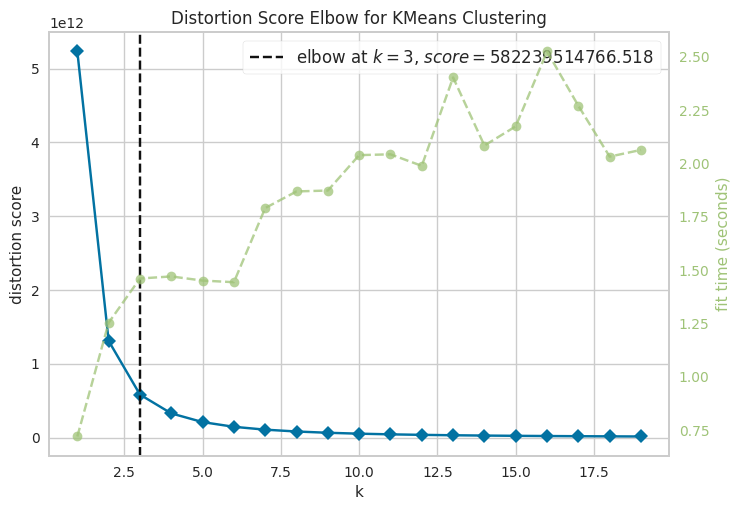

In [351]:
kmeans = KMeans(init='k-means++', random_state=44)
visualizer = KElbowVisualizer(kmeans, k=(1,20))
visualizer.fit(X_train.iloc[:,:-1])
visualizer.show()
plt.show()

    Evaluation

In [352]:
y_train_pred = kmeans1.predict(X_train.iloc[:,:-1])
y_pred = kmeans1.predict(X_test.iloc[:,:-1])
y_train = X_train.iloc[:,-1]
y_test = X_test.iloc[:,-1]

Model Train Score is :  0.4335330310880829
Model Test Score is :  0.4434191355026712
F1 Score is :  0.07580645161290323
Recall Score is :  0.19831223628691982
Precision Score is :  0.04685942173479561
AUC Value  :  0.3368070511840746


Classification Report is :                precision    recall  f1-score   support

         0.0       0.82      0.48      0.60      3644
         1.0       0.05      0.20      0.08       474

    accuracy                           0.44      4118
   macro avg       0.43      0.34      0.34      4118
weighted avg       0.73      0.44      0.54      4118

Confusion Matrix is : 
 [[1732 1912]
 [ 380   94]]


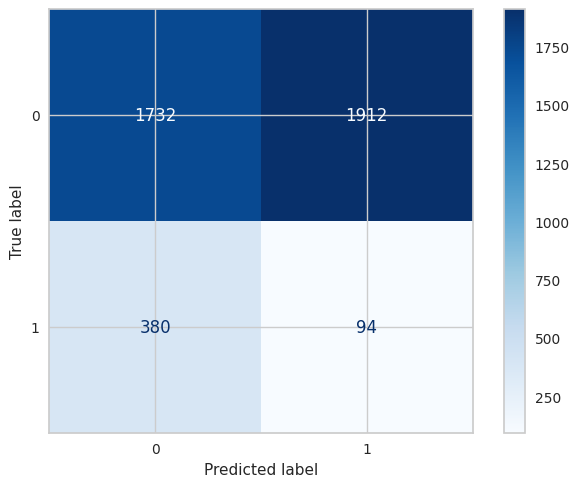

In [353]:
value_kmeans = Check(cluster=1,y_pred=y_pred)

    AgglomerativeClustering

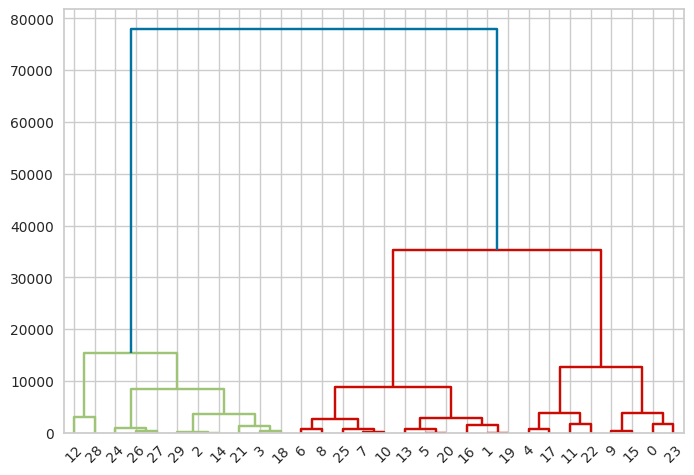

In [354]:
den = sch.dendrogram(sch.linkage(X_train.iloc[: 30,:-1], method = 'ward'))

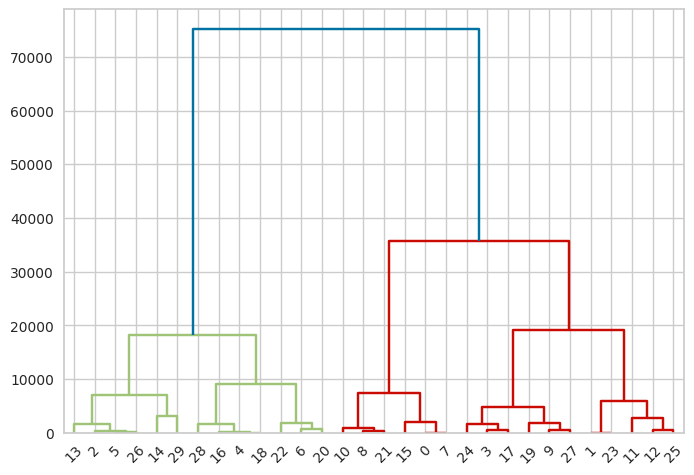

In [355]:
den = sch.dendrogram(sch.linkage(X_test.iloc[: 30,:-1], method = 'ward'))

In [356]:
AggClusteringModel = AgglomerativeClustering(n_clusters=2,affinity='euclidean',linkage='ward')
y_train_pred = AggClusteringModel.fit_predict(X_train.iloc[:,:-1])
y_pred = AggClusteringModel.fit_predict(X_test.iloc[:,:-1])

In [357]:
y_train = X_train.iloc[:,-1]
y_test = X_test.iloc[:,-1]

Model Train Score is :  0.6223013816925734
Model Test Score is :  0.5709082078678971
F1 Score is :  0.06458443620963472
Recall Score is :  0.12869198312236288
Precision Score is :  0.0431095406360424
AUC Value  :  0.37856113974998495


Classification Report is :                precision    recall  f1-score   support

         0.0       0.85      0.63      0.72      3644
         1.0       0.04      0.13      0.06       474

    accuracy                           0.57      4118
   macro avg       0.45      0.38      0.39      4118
weighted avg       0.75      0.57      0.65      4118

Confusion Matrix is : 
 [[2290 1354]
 [ 413   61]]


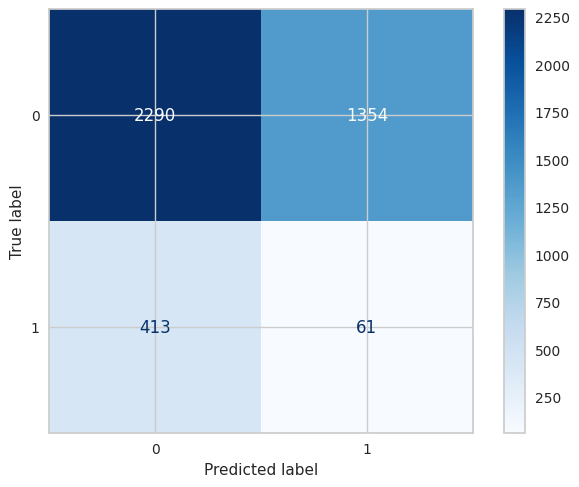

In [358]:
value_agg = Check(cluster=1,y_pred=y_pred)

In [359]:
list = [value_kmeans,value_agg]
df = pd.DataFrame(list,columns=['Train Accuracy','Test Accuracy','Test F1','Test Recall','Test Precision','AUC'])
df['Models'] = ['Kmeans','AgglomerativeClustering']
df.set_index('Models', inplace=True)
df

,Train Accuracy,Test Accuracy,Test F1,Test Recall,Test Precision,AUC
Models,,,,,,
Kmeans,0.433533,0.443419,0.075806,0.198312,0.046859,0.336807
AgglomerativeClustering,0.622301,0.570908,0.064584,0.128692,0.043110,0.378561


In [360]:
models_draw(df)

**<a id="6"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">DL Models 🕵️‍♂️🕵️‍♂️</p>
<a class="btn" href="#home">Tabel of Contents</a>

    Deep Learning Models

In [361]:
X_train_c,y_train_c,X_test_c,y_test_c=Split(X_classification,y_classification)
X_train_r,y_train_r,X_test_r,y_test_r=Split(X_regression,y_regression,classification=0)

X_train shape is  (37056, 20)
X_test shape is  (4118, 20)
y_train shape is  (37056,)
y_test shape is  (4118,)
X_train shape is  (37056, 20)
X_test shape is  (4118, 20)
y_train shape is  (37056,)
y_test shape is  (4118,)


In [362]:
classification_Input = keras.Input(shape=(X_classification.shape[1],))
regression_Input = keras.Input(shape=(X_regression.shape[1],))

dense_layer1 = keras.layers.Dense(512, activation='relu', name='Dense_Layer1')
dense_layer2 = keras.layers.Dense(256, activation='relu', name='Dense_Layer2')

classification_output = dense_layer1(classification_Input)
regression_output = dense_layer1(regression_Input)

layer = dense_layer2(classification_output)
layer2 = dense_layer2(regression_output)
layer_C = keras.layers.Dense(1, activation='sigmoid', name='Dense_Layer3')(layer)
layer_R = keras.layers.Dense(1, name='Dense_Layer4')(layer2)

model = keras.Model(inputs=[classification_Input, regression_Input], outputs=[layer_C, layer_R])


In [363]:
model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 20)        │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ input_layer_1       │ (None, 20)        │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Dense_Layer1        │ (None, 512)       │     10,752 │ input_layer[0][0… │
│ (Dense)             │                   │            │ input_layer_1[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Dense_Layer2        │ (None, 256)       │    131,328 │ Dense_Layer1[0][… │
│ (Dense)             │                   │            │ Dense_Layer1[1][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Dense_Layer3        │ (None, 1)         │        257 │ Dense_Layer2[0][… │
│ (Dense)             │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Dense_Layer4        │ (None, 1)         │        257 │ Dense_Layer2[1][… │
│ (Dense)             │                   │            │                   │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 142,594 (557.01 KB)

 Trainable params: 142,594 (557.01 KB)

 Non-trainable params: 0 (0.00 B)

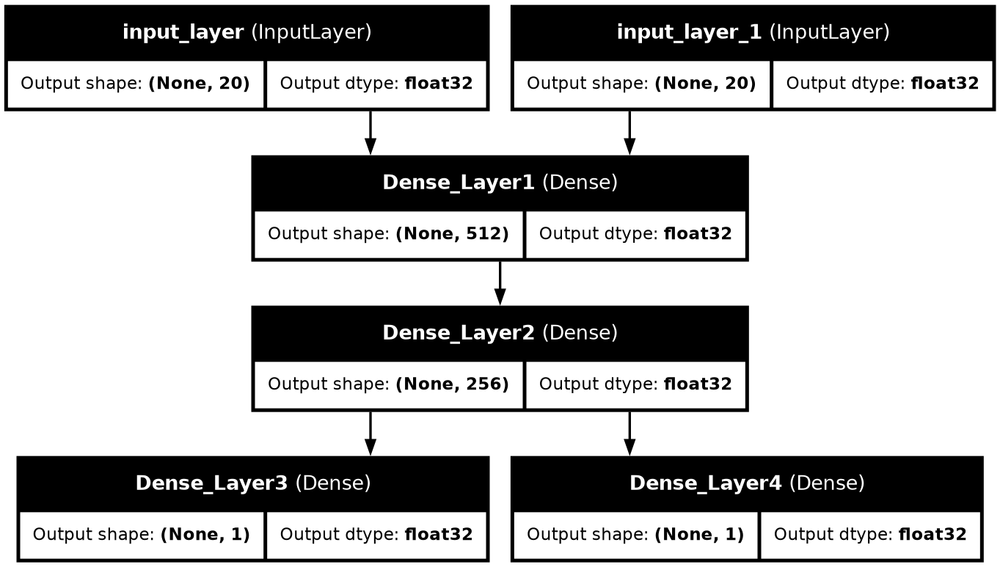

In [364]:
keras.utils.plot_model(model, to_file='model.png', show_shapes=True, show_layer_names=True,show_dtype=True,dpi=120)

In [365]:
model.compile(optimizer='adam', 
              loss={'Dense_Layer3': 'binary_crossentropy', 'Dense_Layer4': 'mse'}, 
              metrics={'Dense_Layer3': 'accuracy', 'Dense_Layer4': 'mae'})
checkpoint_cb = keras.callbacks.ModelCheckpoint("my_keras_model.keras", save_best_only=True)
early_stopping_cb = keras.callbacks.EarlyStopping(patience=10, restore_best_weights=True)
hist = model.fit([X_train_c, X_train_r], [y_train_c, y_train_r], 
          epochs=50, 
          batch_size=32,validation_split=.1, 
          callbacks=[checkpoint_cb, early_stopping_cb])

Epoch 1/50
1043/1043 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - Dense_Layer3_accuracy: 0.8470 - Dense_Layer4_mae: 28.5478 - loss: 7721.0005 - val_Dense_Layer3_accuracy: 0.9021 - val_Dense_Layer4_mae: 0.3544 - val_loss: 2.6956
Epoch 2/50
1043/1043 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - Dense_Layer3_accuracy: 0.8563 - Dense_Layer4_mae: 0.4615 - loss: 2.4969 - val_Dense_Layer3_accuracy: 0.9015 - val_Dense_Layer4_mae: 3.7310 - val_loss: 14.8252
Epoch 3/50
1043/1043 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - Dense_Layer3_accuracy: 0.8732 - Dense_Layer4_mae: 5.1036 - loss: 106.1254 - val_Dense_Layer3_accuracy: 0.7450 - val_Dense_Layer4_mae: 0.3891 - val_loss: 0.9132
Epoch 4/50
1043/1043 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - Dense_Layer3_accuracy: 0.8633 - Dense_Layer4_mae: 0.6236 - loss: 3.8121 - val_Dense_Layer3_accuracy: 0.9015 - val_Dense_Layer4_mae: 3.5650 - val_loss: 13.3524
Epoch 5/50
1043/1043 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - Dense_Layer3_accuracy: 0.8737 - Dense_Layer4_mae: 4.1479 - loss: 56.3815 - val_D

In [366]:
model.evaluate([X_test_c, X_test_r], [y_test_c, y_test_r])

129/129 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - Dense_Layer3_accuracy: 0.9038 - Dense_Layer4_mae: 0.2205 - loss: 0.2787


[0.2739770710468292, 0.902622640132904, 0.2176852524280548]

In [367]:
hist_=pd.DataFrame(hist.history)
hist_

,Dense_Layer3_accuracy,Dense_Layer4_mae,loss,val_Dense_Layer3_accuracy,val_Dense_Layer4_mae,val_loss
0,0.854513,6.727974,1462.873047,0.902051,0.354356,2.695616
1,0.858531,0.553763,2.341208,0.901511,3.731010,14.825179
2,0.867436,5.540781,154.833618,0.745008,0.389077,0.913190
3,0.868006,1.573190,15.134027,0.901511,3.564971,13.352432
4,0.878561,3.521467,47.304001,0.907987,1.886879,4.122301
5,0.884648,3.074395,21.081865,0.902321,2.408710,6.157383
6,0.886237,2.160619,46.481407,0.884781,0.778311,1.005044
7,0.888066,0.729742,2.285433,0.909606,5.469322,30.212744
8,0.893613,1.818869,19.401600,0.906638,0.334186,0.363812
9,0.893883,0.641961,1.305244,0.899892,2.454597,6.459667


In [368]:
def summary_plot():
    fig = make_subplots(rows=2, cols=2, subplot_titles=("Total Loss",'', "Classification Accuracy", "Regression MAE"))
    fig.add_trace(go.Scatter(x=hist_.index, y=hist_['loss'], mode='lines', name='Total Loss', line=dict(color='blue')), row=1, col=1)
    fig.add_trace(go.Scatter(x=hist_.index, y=hist_['val_loss'], mode='lines', name='Validation Loss', line=dict(color='orange')), row=1, col=1)
    fig.add_trace(go.Scatter(x=hist_.index, y=hist_['Dense_Layer3_accuracy'], mode='lines', name='Train Classification Accuracy', line=dict(color='red')), row=2, col=1)
    fig.add_trace(go.Scatter(x=hist_.index, y=hist_['val_Dense_Layer3_accuracy'], mode='lines', name='Validation Classification Accuracy', line=dict(color='red')), row=2, col=1)
    fig.add_trace(go.Scatter(x=hist_.index, y=hist_['Dense_Layer4_mae'], mode='lines', name='Train Regression MAE', line=dict(color='purple')), row=2, col=2)
    fig.add_trace(go.Scatter(x=hist_.index, y=hist_['val_Dense_Layer4_mae'], mode='lines', name='Validation Regression MAE', line=dict(color='purple')), row=2, col=2)
    fig.update_layout(
        title_text="Training Summary",
        title_x=0.5,
        title_font=dict(size=20),
        font=dict(size=15),
        width=1100,
        height=1000,
        template='plotly_dark'
    )
    fig.update_annotations(font=dict(size=20))
    fig.show()

In [369]:
summary_plot()

In [370]:
predictions = model.predict([X_test_c,X_test_r])

129/129 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


In [371]:
classification_predictions = np.where(predictions[0]>=.5,1,0)
regression_predictions = predictions[1]

In [372]:
def Check(model_22 = 1):
    if model_22:
        train = accuracy_score(y_train_c,np.where(model.predict([X_train_c,X_train_r])[0]>=.5,1,0))
    else:
        train = accuracy_score(y_train_c,np.where(model2.predict(X_train_c)>=.5,1,0))
    y_pred=classification_predictions
    test = accuracy_score(y_test_c,y_pred)
    print('Model Train Score is : ' , train)
    print('Model Test Score is : ' , test)
    F1Score = f1_score(y_test_c, y_pred) 
    print('F1 Score is : ', F1Score)
    RecallScore = recall_score(y_test_c, y_pred) 
    print('Recall Score is : ', RecallScore)
    PrecisionScore = precision_score(y_test_c, y_pred)
    print('Precision Score is : ', PrecisionScore)
    fprValue2, tprValue2, thresholdsValue2 = roc_curve(y_test_c,y_pred)
    AUCValue = auc(fprValue2, tprValue2)
    print('AUC Value  : ', AUCValue)
    Area(fprValue2,tprValue2,AUCValue)
    ClassificationReport = classification_report(y_test_c,y_pred)
    print('Classification Report is : ', ClassificationReport)
    CM = confusion_matrix(y_test_c, y_pred)
    print('Confusion Matrix is : \n', CM)
    disp = ConfusionMatrixDisplay(confusion_matrix=CM, display_labels=[0,1])
    disp.plot(cmap='Blues')
    values=[train,test,F1Score,RecallScore,PrecisionScore,AUCValue]
    return values
def Check_R():
    y_pred = regression_predictions
    print('R2 Score Train :',r2_score(y_train_c,model.predict([X_train_c,X_train_r])[1]))
    print('R2 Score Test :',r2_score(y_test_c,y_pred))
    MAEValue = mean_absolute_error(y_test_c, y_pred)
    print('Mean Absolute Error Value is : ', MAEValue)
    MSEValue = mean_squared_error(y_test_c, y_pred)
    print('Mean Squared Error Value is : ', MSEValue)
    MdSEValue = median_absolute_error(y_test_c, y_pred)
    print('Median Absolute Error Value is : ', MdSEValue )

1158/1158 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
Model Train Score is :  0.9067087651122625
Model Test Score is :  0.902622632345799
F1 Score is :  0.44689655172413795
Recall Score is :  0.34913793103448276
Precision Score is :  0.6206896551724138
AUC Value  :  0.6610221674876847


Classification Report is :                precision    recall  f1-score   support

           0       0.92      0.97      0.95      3654
           1       0.62      0.35      0.45       464

    accuracy                           0.90      4118
   macro avg       0.77      0.66      0.70      4118
weighted avg       0.89      0.90      0.89      4118

Confusion Matrix is : 
 [[3555   99]
 [ 302  162]]


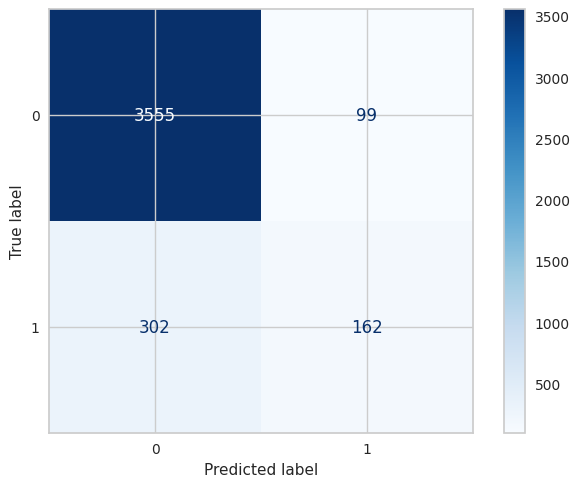

In [373]:
values_d = Check()

In [374]:
Check_R()

1158/1158 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
R2 Score Train : -0.6742871514142943
R2 Score Test : -0.6779477279430051
Mean Absolute Error Value is :  0.40111354211252137
Mean Squared Error Value is :  0.16776148678501776
Median Absolute Error Value is :  0.37006551027297974


    RandomOverSampler

In [375]:
X_train_c,y_train_c,X_test_c,y_test_c=Split(X_classification_over,y_classification_over)

X_train shape is  (65763, 20)
X_test shape is  (7307, 20)
y_train shape is  (65763,)
y_test shape is  (7307,)


In [376]:
model2 = keras.Model(inputs=[classification_Input], outputs=[layer_C])
model2.summary()

Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 20)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Dense_Layer1 (Dense)            │ (None, 512)            │        10,752 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Dense_Layer2 (Dense)            │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Dense_Layer3 (Dense)            │ (None, 1)              │           257 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 142,337 (556.00 KB)

 Trainable params: 142,337 (556.00 KB)

 Non-trainable params: 0 (0.00 B)

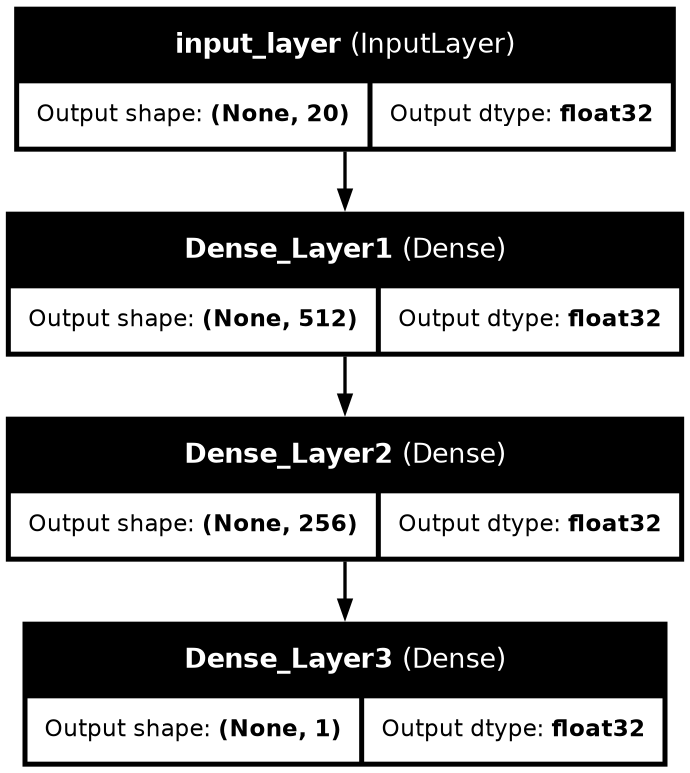

In [377]:
keras.utils.plot_model(model2, to_file='model.png', show_shapes=True, show_layer_names=True,show_dtype=True,dpi=120)

In [378]:
model2.compile(optimizer='adam', 
              loss={'Dense_Layer3': 'binary_crossentropy'}, 
              metrics={'Dense_Layer3': 'accuracy'})
hist = model2.fit(X_train_c,y_train_c, 
          epochs=50, 
          batch_size=32,validation_split=.1, 
          callbacks=[checkpoint_cb, early_stopping_cb])

Epoch 1/50
1850/1850 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - accuracy: 0.8560 - loss: 0.3446 - val_accuracy: 0.8553 - val_loss: 0.3410
Epoch 2/50
1850/1850 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - accuracy: 0.8564 - loss: 0.3372 - val_accuracy: 0.8546 - val_loss: 0.3319
Epoch 3/50
1850/1850 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - accuracy: 0.8563 - loss: 0.3358 - val_accuracy: 0.8504 - val_loss: 0.3436
Epoch 4/50
1850/1850 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - accuracy: 0.8587 - loss: 0.3386 - val_accuracy: 0.8621 - val_loss: 0.3298
Epoch 5/50
1850/1850 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - accuracy: 0.8580 - loss: 0.3346 - val_accuracy: 0.8495 - val_loss: 0.3482
Epoch 6/50
1850/1850 ━━━━━━━━━━━━━━━━━━━━ 10s 3ms/step - accuracy: 0.8572 - loss: 0.3348 - val_accuracy: 0.8626 - val_loss: 0.3408
Epoch 7/50
1850/1850 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - accuracy: 0.8590 - loss: 0.3344 - val_accuracy: 0.8551 - val_loss: 0.3367
Epoch 8/50
1850/1850 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - accuracy: 0.8612 - loss: 0.3290 -

In [379]:
model2.evaluate(X_test_c,y_test_c)

229/229 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8519 - loss: 0.3485


[0.33560916781425476, 0.8560284376144409]

In [380]:
hist_=pd.DataFrame(hist.history)
hist_

,accuracy,loss,val_accuracy,val_loss
0,0.856199,0.341449,0.855253,0.340966
1,0.856757,0.338065,0.854645,0.331923
2,0.856976,0.336241,0.850388,0.343551
3,0.859477,0.335664,0.862095,0.329773
4,0.858835,0.334564,0.849475,0.348236
5,0.857635,0.334425,0.862551,0.340766
6,0.860018,0.332961,0.855101,0.336699
7,0.858869,0.332023,0.864224,0.330868
8,0.858784,0.332989,0.863768,0.329161
9,0.858919,0.332874,0.854189,0.336729


In [381]:
def summary_plot2():
    fig = make_subplots(rows=1, cols=2, subplot_titles=("Total Loss","Classification Accuracy"))
    fig.add_trace(go.Scatter(x=hist_.index, y=hist_['loss'], mode='lines', name='Train Loss', line=dict(color='blue')), row=1, col=1)
    fig.add_trace(go.Scatter(x=hist_.index, y=hist_['val_loss'], mode='lines', name='Validation Loss', line=dict(color='blue')), row=1, col=1)
    fig.add_trace(go.Scatter(x=hist_.index, y=hist_['accuracy'], mode='lines', name='Train Accuracy', line=dict(color='red')), row=1, col=2)
    fig.add_trace(go.Scatter(x=hist_.index, y=hist_['val_accuracy'], mode='lines', name='Validation Accuracy', line=dict(color='red')), row=1, col=2)
    fig.update_layout(
        title_text="Training Summary",
        title_x=0.5,
        title_font=dict(size=20),
        font=dict(size=15),
        width=1100,
        height=600,
        template='plotly_dark'
    )
    fig.update_annotations(font=dict(size=20))
    fig.show()

In [382]:
summary_plot2()

In [383]:
predictions = model2.predict(X_test_c)

229/229 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


In [384]:
classification_predictions = np.where(predictions>=.5,1,0)

2056/2056 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step
Model Train Score is :  0.8573209859647523
Model Test Score is :  0.85602846585466
F1 Score is :  0.8574525745257453
Recall Score is :  0.8661374212975637
Precision Score is :  0.8489401663536357
AUC Value  :  0.8560298491271616


Classification Report is :                precision    recall  f1-score   support

           0       0.86      0.85      0.85      3654
           1       0.85      0.87      0.86      3653

    accuracy                           0.86      7307
   macro avg       0.86      0.86      0.86      7307
weighted avg       0.86      0.86      0.86      7307

Confusion Matrix is : 
 [[3091  563]
 [ 489 3164]]


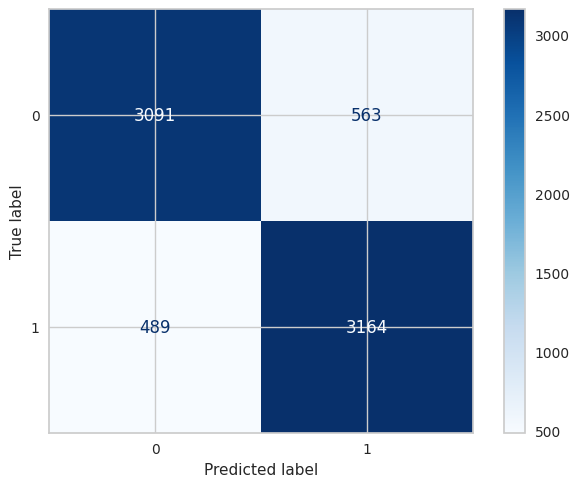

In [385]:
value_d_over = Check(model_22=0)

    RandomUnderSampler

In [386]:
X_train_c,y_train_c,X_test_c,y_test_c=Split(X_classification_under,y_classification_under)

X_train shape is  (8350, 20)
X_test shape is  (928, 20)
y_train shape is  (8350,)
y_test shape is  (928,)


In [387]:
hist = model2.fit(X_train_c,y_train_c, 
          epochs=50, 
          batch_size=32,validation_split=.1,
          callbacks=[checkpoint_cb, early_stopping_cb])

Epoch 1/50
235/235 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8475 - loss: 0.3582 - val_accuracy: 0.8743 - val_loss: 0.3138
Epoch 2/50
235/235 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8513 - loss: 0.3513 - val_accuracy: 0.8671 - val_loss: 0.3189
Epoch 3/50
235/235 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8512 - loss: 0.3453 - val_accuracy: 0.8623 - val_loss: 0.3238
Epoch 4/50
235/235 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.8504 - loss: 0.3451 - val_accuracy: 0.8754 - val_loss: 0.3184
Epoch 5/50
235/235 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8611 - loss: 0.3388 - val_accuracy: 0.8778 - val_loss: 0.3168
Epoch 6/50
235/235 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.8507 - loss: 0.3467 - val_accuracy: 0.8754 - val_loss: 0.3158
Epoch 7/50
235/235 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8471 - loss: 0.3520 - val_accuracy: 0.8719 - val_loss: 0.3167
Epoch 8/50
235/235 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8405 - loss: 0.3610 - val_accuracy: 0.

In [388]:
model2.evaluate(X_test_c,y_test_c)

29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8850 - loss: 0.2949 


[0.2965400815010071, 0.8793103694915771]

In [389]:
hist_=pd.DataFrame(hist.history)
hist_

,accuracy,loss,val_accuracy,val_loss
0,0.845509,0.359167,0.874251,0.313803
1,0.854558,0.346112,0.867066,0.318930
2,0.850166,0.347013,0.862275,0.323799
3,0.850832,0.344415,0.875449,0.318440
4,0.854691,0.346464,0.877844,0.316790
5,0.854158,0.346115,0.875449,0.315809
6,0.850432,0.347666,0.871856,0.316675
7,0.850299,0.346432,0.862275,0.327360
8,0.854558,0.348872,0.862275,0.327996
9,0.852428,0.345106,0.876647,0.316220


In [390]:
summary_plot2()

In [391]:
predictions = model2.predict(X_test_c)

29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 


In [392]:
classification_predictions = np.where(predictions>=.5,1,0)

261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Model Train Score is :  0.8573652694610778
Model Test Score is :  0.8793103448275862
F1 Score is :  0.8835758835758836
Recall Score is :  0.915948275862069
Precision Score is :  0.8534136546184738
AUC Value  :  0.8793103448275861


Classification Report is :                precision    recall  f1-score   support

           0       0.91      0.84      0.87       464
           1       0.85      0.92      0.88       464

    accuracy                           0.88       928
   macro avg       0.88      0.88      0.88       928
weighted avg       0.88      0.88      0.88       928

Confusion Matrix is : 
 [[391  73]
 [ 39 425]]


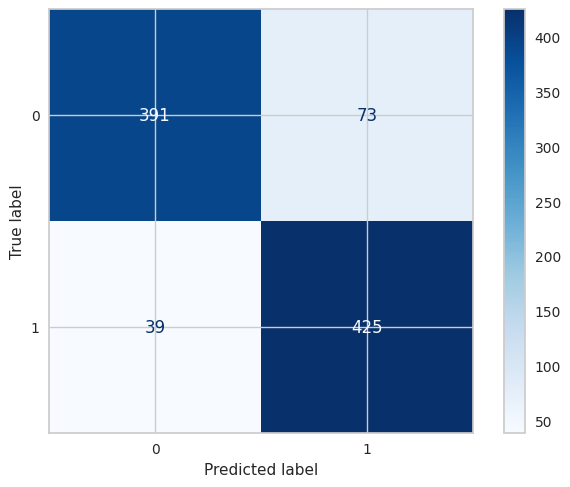

In [393]:
value_d_under = Check(model_22=0)

In [394]:
list = [values_d,value_d_over,value_d_under]
df = pd.DataFrame(list,columns=['Train Accuracy','Test Accuracy','Test F1','Test Recall','Test Precision','AUC'])
df['Models'] = ['Deep Learning','Deep Learning With Over','Deep Learning With Under']
df.set_index('Models', inplace=True)
df

,Train Accuracy,Test Accuracy,Test F1,Test Recall,Test Precision,AUC
Models,,,,,,
Deep Learning,0.906709,0.902623,0.446897,0.349138,0.620690,0.661022
Deep Learning With Over,0.857321,0.856028,0.857453,0.866137,0.848940,0.856030
Deep Learning With Under,0.857365,0.879310,0.883576,0.915948,0.853414,0.879310


In [395]:
models_draw(df)